In [1]:
import pyvisa as visa
import nidaqmx
import time
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
import os
from scipy.optimize import curve_fit as cf
import math

In [ ]:
rm = visa.ResourceManager()

In [43]:
rm.list_resources()  

('USB0::0x0699::0x0363::C065092::INSTR',
 'USB0::0x0699::0x0346::C033248::INSTR',
 'ASRL1::INSTR',
 'ASRL2::INSTR',
 'ASRL3::INSTR',
 'ASRL10::INSTR')

In [45]:
osci=rm.open_resource('USB0::0x0699::0x0363::C065092::INSTR')
print(osci.query('*IDN?'))

fungen=rm.open_resource('USB0::0x0699::0x0346::C033248::INSTR')
print(fungen.query('*IDN?'))

TEKTRONIX,TDS 1002B,C065092,CF:91.1CT FV:v22.11

TEKTRONIX,AFG3021B,C033248,SCPI:99.0 FV:3.2.0



In [30]:
def save1(name,folder,autos=False,display='t'):
    time_s = time.time()
    
    if autos:
        osci.write('AUTOS exec')
        time.sleep(6)
    
    if display == 'xy':
        osci.write('DIS:XY')
    elif display == 't':
        osci.write('DIS:YT')
            
    osci.write('DAT:SOU CH1')
    xze, xin = osci.query_ascii_values('WFMPRE:XZE?;XIN?', separator=';')
    #osci.write('ACQ:STATE STOP')
    yze1, ymu1, yoff1 = osci.query_ascii_values('WFMPRE:YZE?;YMU?;YOFF?;', separator=';')
    osci.write('DAT:SOU CH2')
    yze2, ymu2, yoff2 = osci.query_ascii_values('WFMPRE:YZE?;YMU?;YOFF?;', separator=';')
    
    osci.write('DAT:ENC RPB')
    osci.write('DAT:WID 1')
    
    osci.write("DAT:SOU CH1")
    data1 = osci.query_binary_values('CURV?', datatype='B', container=np.array)
    osci.write("DAT:SOU CH2")
    data2 = osci.query_binary_values('CURV?', datatype='B', container=np.array)
    tiempo = xze + np.arange(len(data1)) * xin
    data1v = (data1 - yoff1) * ymu1 + yze1
    data2v = (data2 - yoff2) * ymu2 + yze2

    osci.write('ACQ:STATE RUN')
    
    if display == 't':
        df = pd.DataFrame({'t':tiempo,'V1':data1v,'V2':data2v})
        plt.plot(df.t,df.V1)
        plt.plot(df.t,df.V2)
    if display == 'xy':
        df = pd.DataFrame({'V1':data1v,'V2':data2v})
        plt.scatter(df.V1,df.V2)
    
    Vpp1 = max(df.V1) - min(df.V1)
    Vpp2 = max(df.V2) - min(df.V2)
    print(f'Vpp1 = {Vpp1}, Vpp2 = {Vpp2}, diff = {Vpp1-Vpp2}')
    
    plt.grid()
    plt.show()
    df.to_csv(f'{folder}/{name}.csv',index=False)

Vpp1 = 4.96, Vpp2 = 5.68, diff = -0.7199999999999998


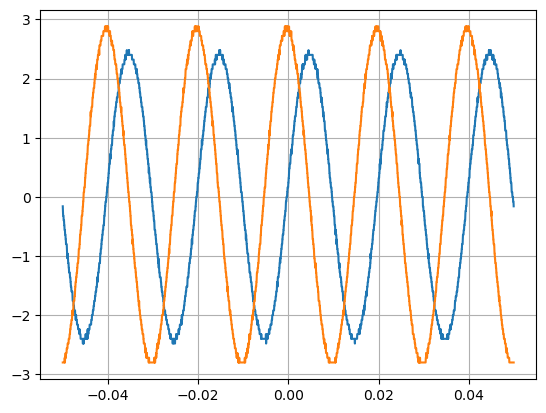

In [54]:
save1('prueba','plots',display='t')

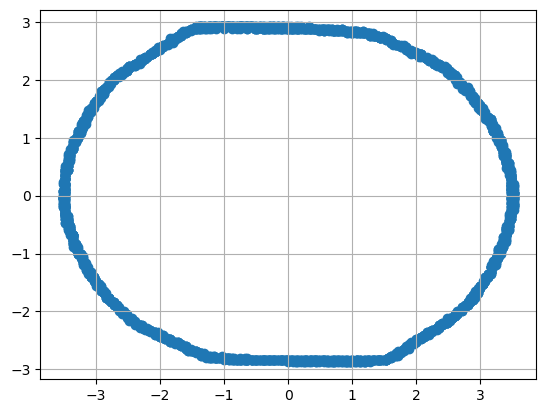

In [33]:
test = pd.read_csv('plots/prueba.csv')
plt.scatter(test.V1,test.V2)
plt.grid()

In [79]:
def barrido_V(V_min,V_max,n,folder):
    volts = np.linspace(V_min,V_max,n)
    
    Vpp = []
    diff = []
    
    for volt in volts:
        fungen.write(f'SOURCE1:VOLT {volt}')
        time.sleep(1)
        osci.write('DAT:SOU CH1')
        xze, xin = osci.query_ascii_values('WFMPRE:XZE?;XIN?', separator=';')
        
        osci.write('ACQ:STATE STOP')
        yze1, ymu1, yoff1 = osci.query_ascii_values('WFMPRE:YZE?;YMU?;YOFF?;', separator=';')
        osci.write('DAT:SOU CH2')
        yze2, ymu2, yoff2 = osci.query_ascii_values('WFMPRE:YZE?;YMU?;YOFF?;', separator=';')
        
        osci.write('DAT:ENC RPB')
        osci.write('DAT:WID 1')
        
        osci.write("DAT:SOU CH1")
        data1 = osci.query_binary_values('CURV?', datatype='B', container=np.array)
        osci.write("DAT:SOU CH2")
        data2 = osci.query_binary_values('CURV?', datatype='B', container=np.array)
        tiempo = xze + np.arange(len(data1)) * xin
        data1v = (data1 - yoff1) * ymu1 + yze1
        data2v = (data2 - yoff2) * ymu2 + yze2

        osci.write('ACQ:STATE RUN')
        
        df = pd.DataFrame({'t':tiempo,'V1':data1v,'V2':data2v})
        plt.plot(df.t,df.V1)
        plt.plot(df.t,df.V2)
        
        Vpp1 = max(df.V1) - min(df.V1)
        Vpp2 = max(df.V2) - min(df.V2)
        Vpp_diff = Vpp1-Vpp2
        
        Vpp.append(Vpp1)
        diff.append(Vpp_diff)
        
        plt.grid()
        plt.show()
        df.to_csv(f'plots/{folder}/{np.round(volt,1)}.csv',index=False)
    return np.array(Vpp),np.array(diff)

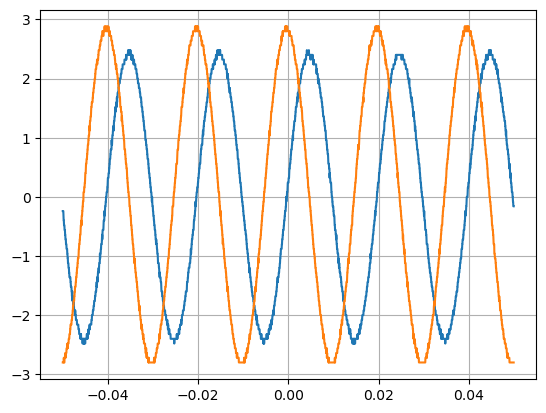

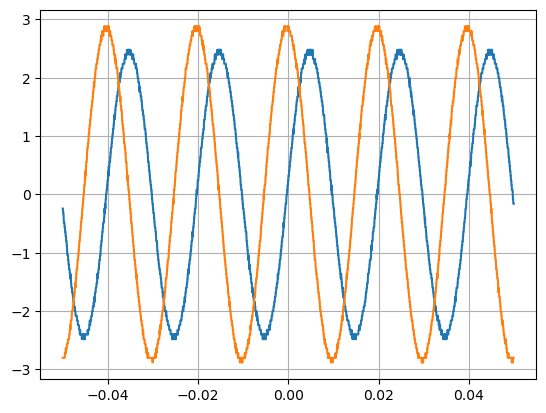

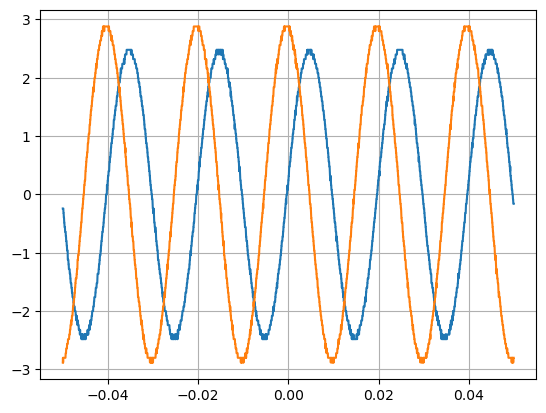

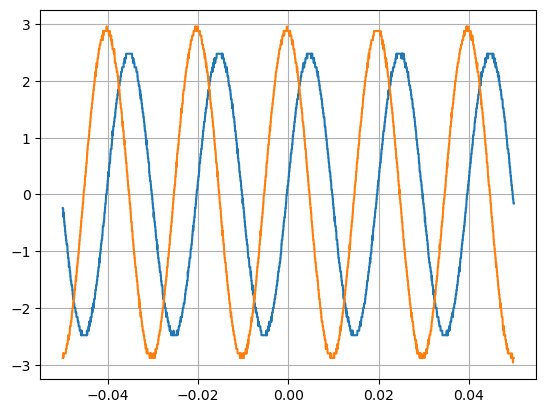

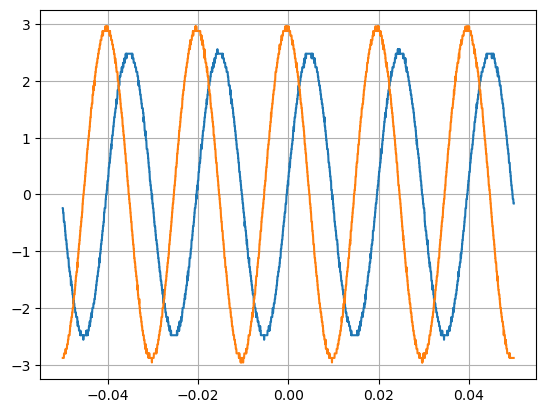

...

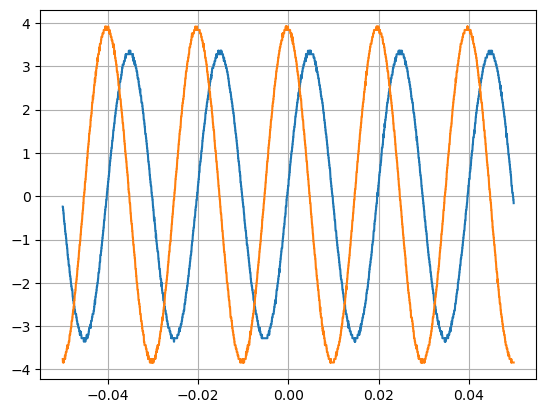

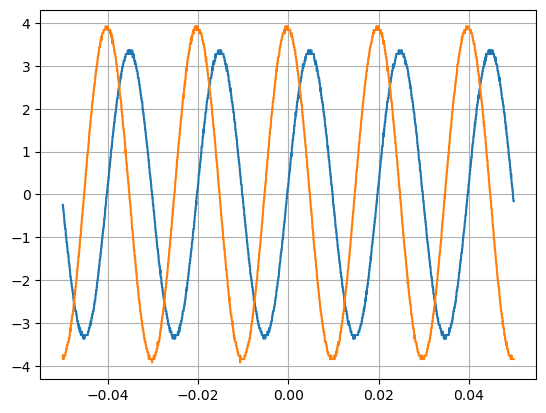

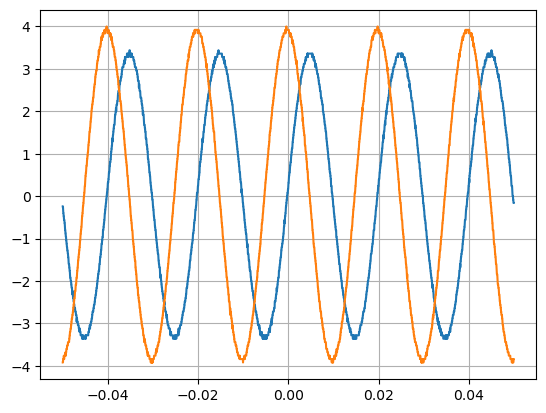

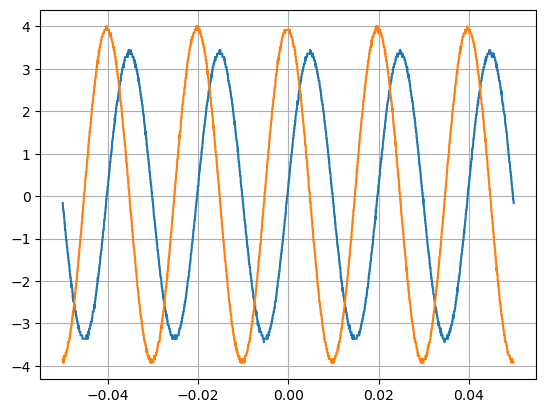

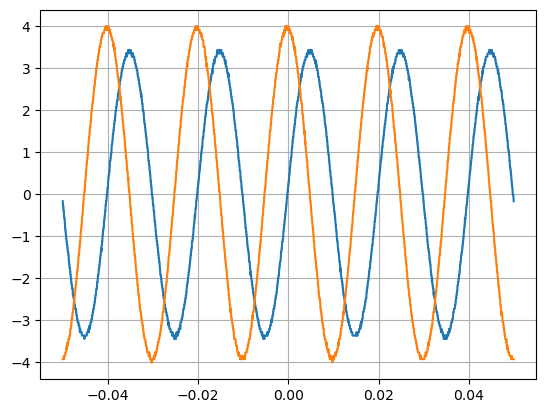

In [80]:
Vpp,diff = barrido_V(5,7,50,'caract')

In [2]:
lineal = lambda x,a,b : a*x+b
sen = lambda x,A,w,phi0 : abs(A)*np.sin(w*x+phi0)

0.13844706188848602 0.13091762850255848


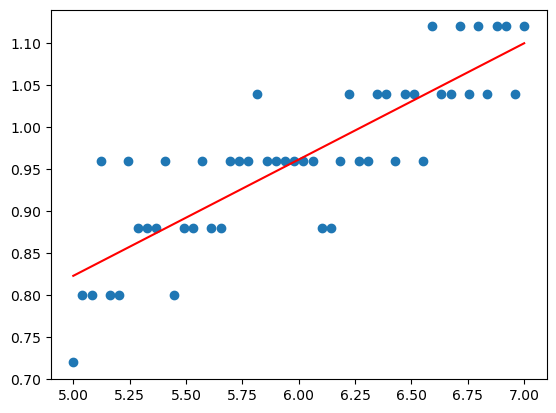

In [81]:
plt.scatter(np.linspace(5,7,50),abs(diff))

pars,cov = cf(lineal,np.linspace(5,7,50),abs(diff))
plt.plot(np.linspace(5,7,100),lineal(np.linspace(5,7,100),*pars),'r')

print(*pars)

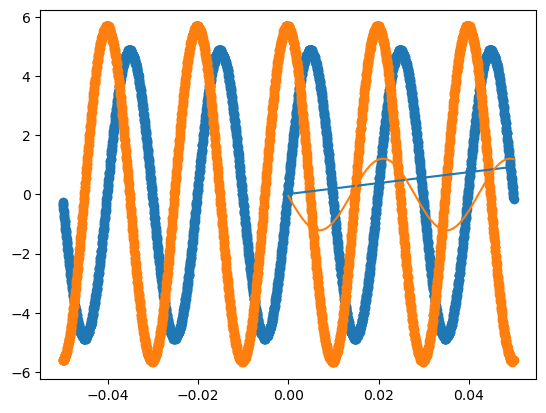

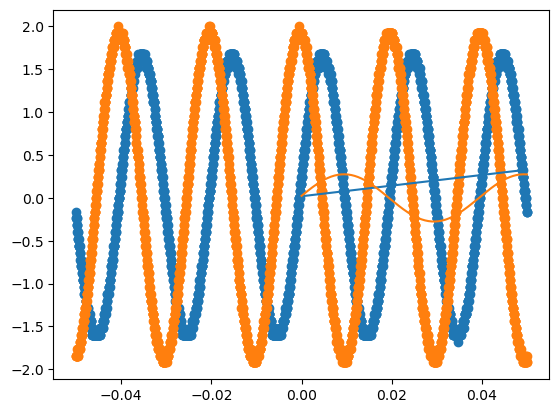

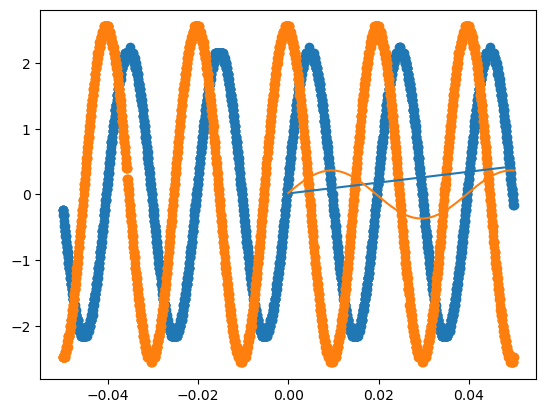

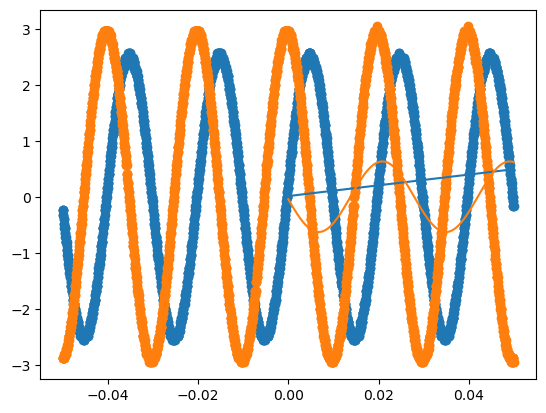

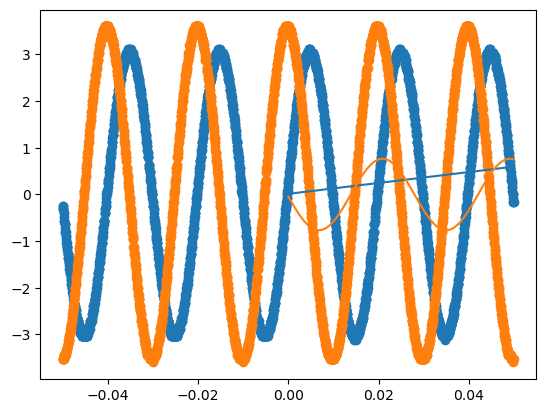

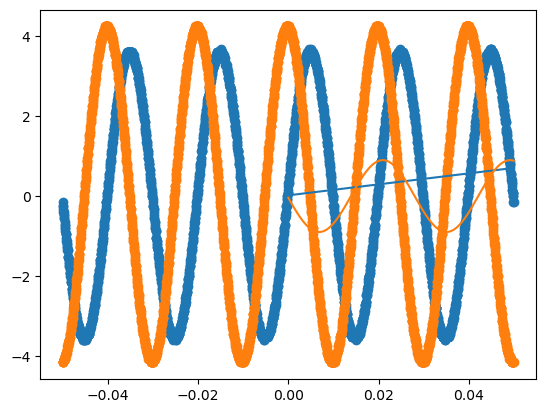

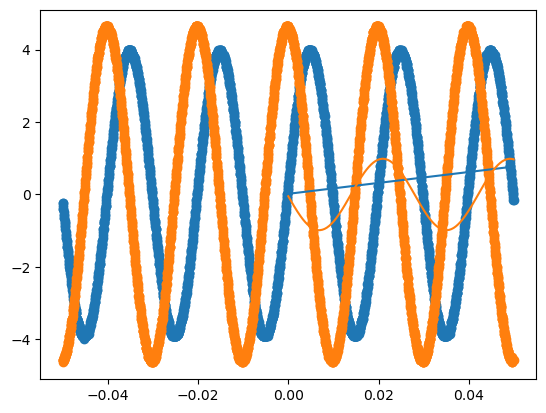

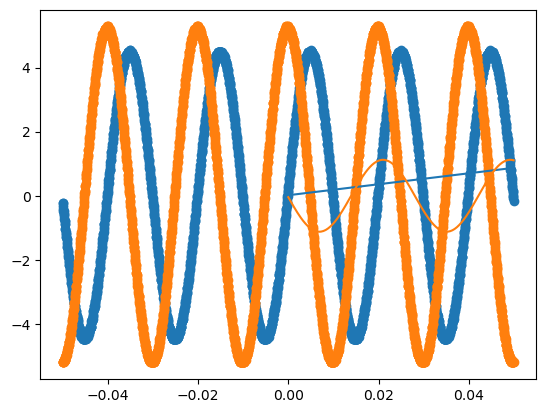

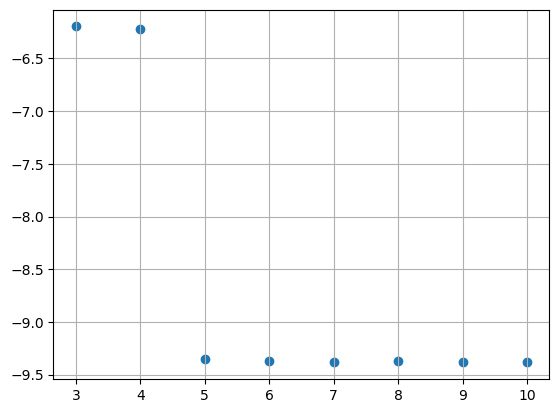

In [92]:
files = os.listdir('plots/caract/barrido1')
names = []
for i in range(len(files)):
    if files[i].endswith('.csv'):
        names.append(float(files[i][:-4]))
names = np.array(names)

phis = []
for i in range(len(names)):
    df = pd.read_csv(f'plots/caract/barrido1/{names[i]}.csv')
    
    pars1,cov1 = cf(sen,df.t,df.V1,p0=[names[i],50/(2*np.pi),0])
    pars2,cov2 = cf(sen,df.t,df.V1,p0=[names[i]*0.85,50/(2*np.pi),np.pi/2])
    
    phi1 = pars1[-1]
    phi2 = pars2[-1]
    
    ts = np.linspace(min(df.T),max(df.t),200)
    plt.scatter(df.t,df.V1)
    plt.plot(ts,sen(ts,*pars1))
    plt.scatter(df.t,df.V2)
    plt.plot(ts,sen(ts,*pars2))
    
    plt.show()
    
    dphi = phi2-phi1
    
    phis.append(dphi)
plt.scatter(names,phis)

plt.grid()

In [3]:
#para saber el ID de la placa conectada (DevX)
system = nidaqmx.system.System.local()
for device in system.devices:
    print(device)

Device(name=Dev1)


In [4]:
#para setear (y preguntar) el modo y rango de un canal analógico
with nidaqmx.Task() as task:
    ai_channel = task.ai_channels.add_ai_voltage_chan("Dev1/ai1",max_val=10,min_val=-10)
    print(ai_channel.ai_term_cfg)    
    print(ai_channel.ai_max)
    print(ai_channel.ai_min)	

TerminalConfiguration.DIFF
10.0
-10.0


In [5]:
def channel(name):
    if name == 'corriente':
        return 2
    if name == 'sin integrar':
        return 4
    if name == 'integrado':
        return 5
    if name == 'voltaje pt':
        return 6
    if name == 'voltaje prueba':
        return 7

In [6]:
## Medicion por tiempo/samples de una sola vez
def medicion_una_vez(channel, duracion, fs):
    if fs > 400000:
        print('Above sampling rate')
        return 0
    cant_puntos = int(duracion*fs)
    with nidaqmx.Task() as task:
        modo= nidaqmx.constants.TerminalConfiguration.DIFF
        task.ai_channels.add_ai_voltage_chan(f'Dev1/ai{channel}', terminal_config = modo)
               
        task.timing.cfg_samp_clk_timing(fs,samps_per_chan = cant_puntos,
                                        sample_mode = nidaqmx.constants.AcquisitionType.FINITE)
        
        datos = task.read(number_of_samples_per_channel=nidaqmx.constants.READ_ALL_AVAILABLE, timeout=duracion+0.1)           
    datos = np.asarray(datos)    
    return datos

def medir_canales(channels,duracion,fs):
    if fs > 400000:
        print('Above sampling rate')
        return 0
    cant_puntos = int(duracion*fs)
    with nidaqmx.Task() as task:
        modo = nidaqmx.constants.TerminalConfiguration.DIFF
        for channel in channels:
            task.ai_channels.add_ai_voltage_chan(f'Dev1/ai{channel}', terminal_config = modo)
#        task.ci_channels.add_ci_count_edges_chan('Dev1/ctr0')
        
#        task.timing.cfg_implicit_timing(sample_mode=nidaqmx.constants.AcquisitionType.FINITE,samps_per_chan=cant_puntos)
               
        task.timing.cfg_samp_clk_timing(fs,samps_per_chan = cant_puntos,
                                        sample_mode = nidaqmx.constants.AcquisitionType.FINITE)
        
        datos = task.read(number_of_samples_per_channel=nidaqmx.constants.READ_ALL_AVAILABLE, timeout=duracion+0.1)
    
    return np.asarray(datos)

In [7]:
temp = lambda R : (R-100)/0.385 + 273.15

In [11]:
def medicion_continua(duracion, fs):
    cant_puntos = int(duracion*fs)
    with nidaqmx.Task() as task:
        modo= nidaqmx.constants.TerminalConfiguration.DIFF
        task.ai_channels.add_ai_voltage_chan(f'Dev1/ai{channel}', terminal_config = modo)
        task.timing.cfg_samp_clk_timing(fs, sample_mode = nidaqmx.constants.AcquisitionType.CONTINUOUS)
        task.start()
        t0 = time.time()
        total = 0
        data =[]
        while total<cant_puntos:
            time.sleep(0.1)
            datos = task.read(number_of_samples_per_channel=nidaqmx.constants.READ_ALL_AVAILABLE)           
            data.extend(datos)
            total = total + len(datos)
            t1 = time.time()
            print("%2.3fs %d %d %2.3f" % (t1-t0, len(datos), total, total/(t1-t0)))            
        return data

In [86]:
canales = [2,4,5,6,7]
names = ['corriente','sin integrar','integrado','voltaje pt','voltaje prueba']
a = medir_canales(canales,0.1,10000)

pars,cov = cf(lineal,a[3]/900,a[4])
print(f'T = {temp(pars[0])}')

T = 65.1480655437079


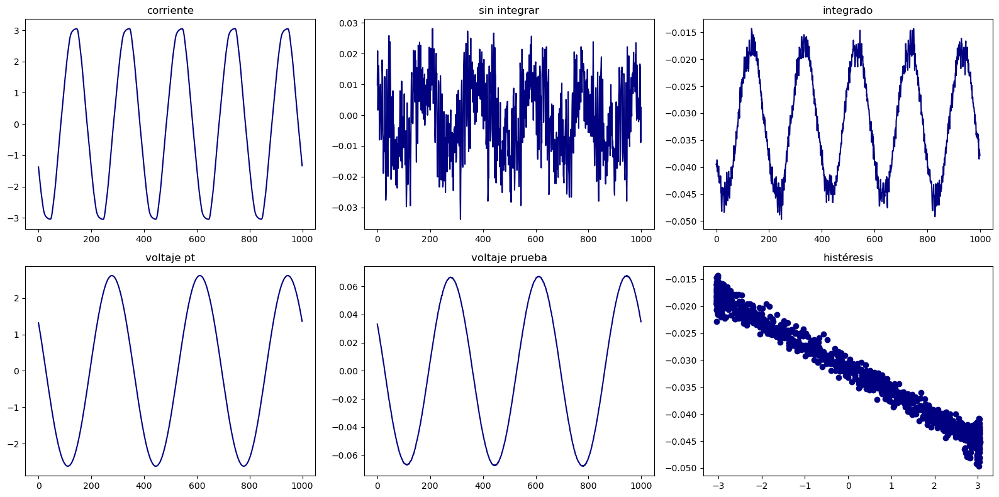

T = 73.2916228094991


In [74]:
canales = [2,4,5,6,7]
names = ['corriente','sin integrar','integrado','voltaje pt','voltaje prueba']
a = medir_canales(canales,0.1,10000)

fig, axs = plt.subplots(2,3,figsize=(16,8))
axs = axs.ravel()
for i in range(len(canales)):
    axs[i].plot(a[i],color='navy')
    axs[i].set_title(names[i])
axs[-1].scatter(-a[0],a[2],color='navy')
axs[-1].set_title('histéresis')
plt.tight_layout()
plt.show()

pars,cov = cf(lineal,a[3]/900,a[4])
print(f'T = {temp(pars[0])}')

In [13]:
pars,cov = cf(lineal,a[3]/900,a[4])
print(f'T = {temp(pars[0])}')

T = 65.10481288412794


In [51]:
def medir_hasta_t(t_f,folder,duracion_single,fs,interval):
    canales = [2,4,5,6,7]
    names = ['corriente','sin integrar','integrado','voltaje pt','voltaje prueba']
    t = 0
    counter = 0
    T = [65.10481288412794]
    dT = 0
    
    while t < t_f:
        counter += 1
        t_start = time.time()
        a = medir_canales(canales,duracion_single,fs)
        a[0] = -a[0]
        
        pars,cov = cf(lineal,a[3]/900,a[4])
        T.append(temp(pars[0]))
        dT = T[-1] - T[-2]
        
        if counter % interval == 0:
            fig, axs = plt.subplots(2,3,figsize=(16,8))
            axs = axs.ravel()
            for i in range(len(canales)):
                axs[i].plot(a[i],color='navy')
                axs[i].set_title(names[i])
            axs[-1].scatter(a[0],a[2],color='navy')
            axs[-1].set_title('histéresis')
            plt.tight_layout()
            plt.show()
            print(f'T = {T[-1]}')
        
        df = pd.DataFrame(np.transpose(a),columns=['V_H','V_Bnint','V_B','V_pt','V_pr'])        
        t_end = time.time()
        t += t_end - t_start
        df.to_csv(f'files/{folder}/{t}.csv')
    print('FINALIZADO')
    return T

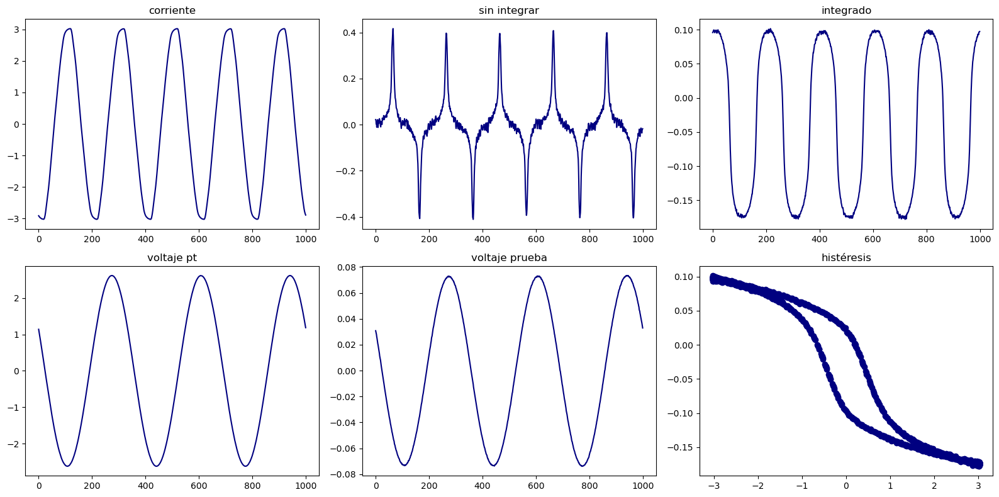

T = 78.82376359834174


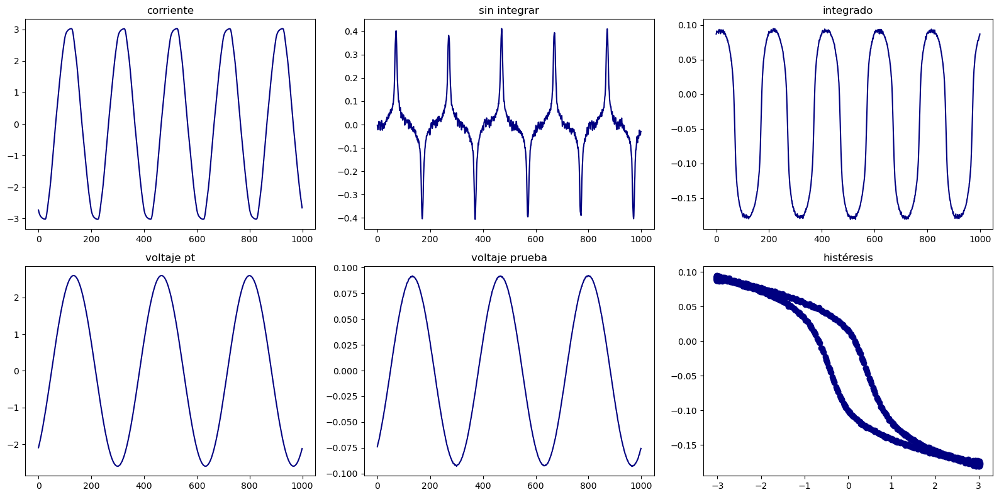

T = 96.25988663458983


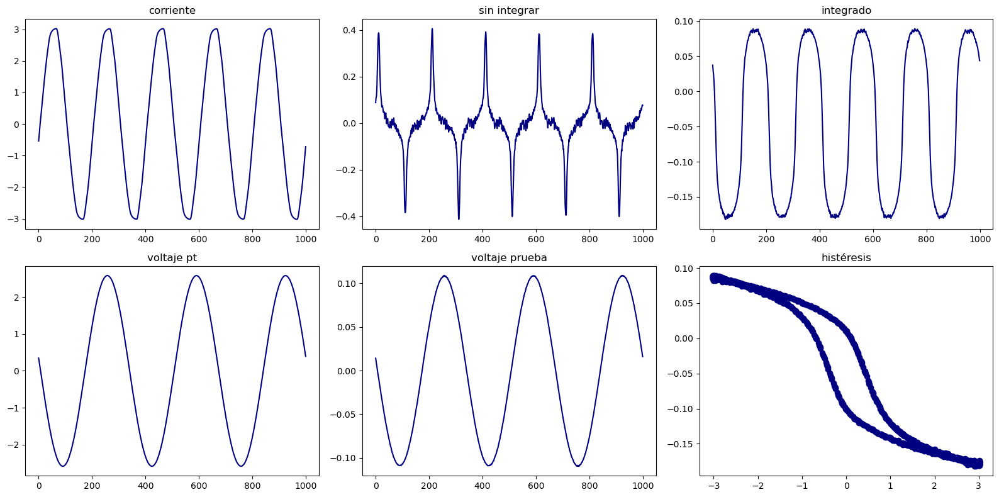

T = 111.88715803077943


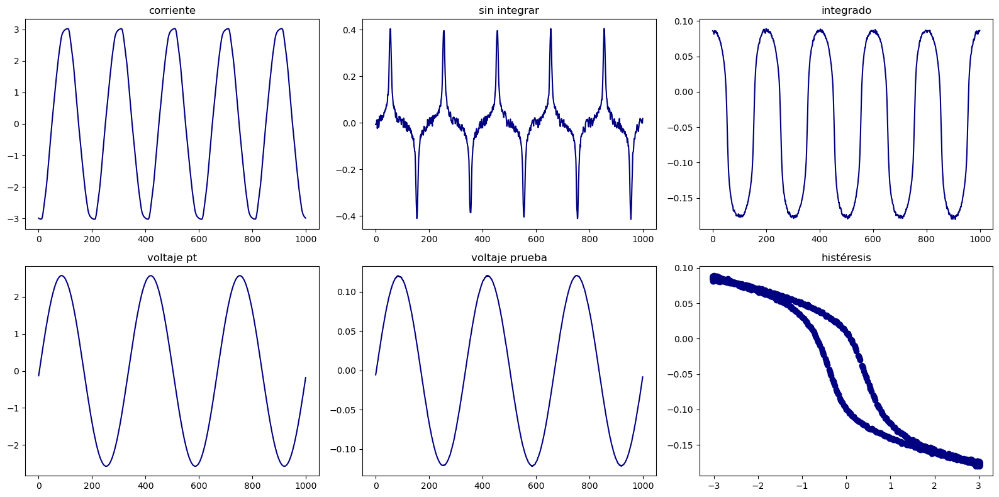

T = 123.13811580758409


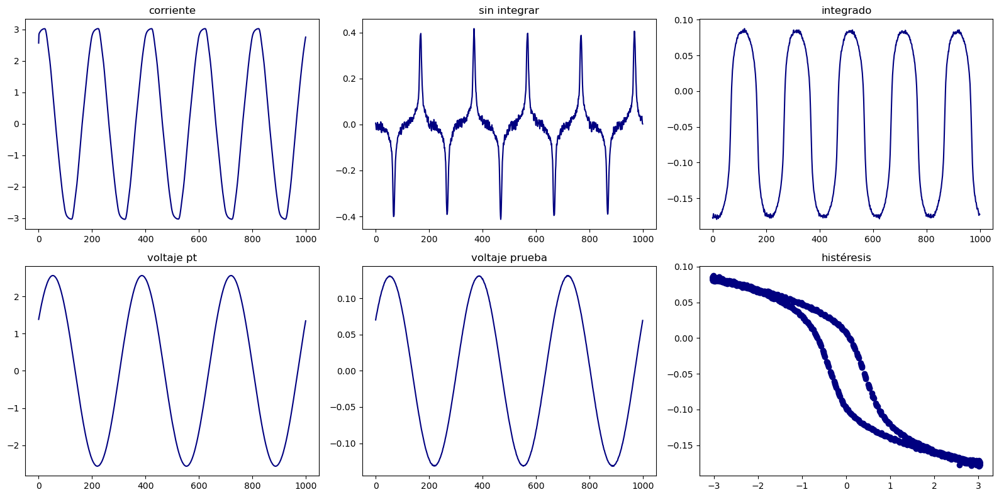

T = 133.00764678536277


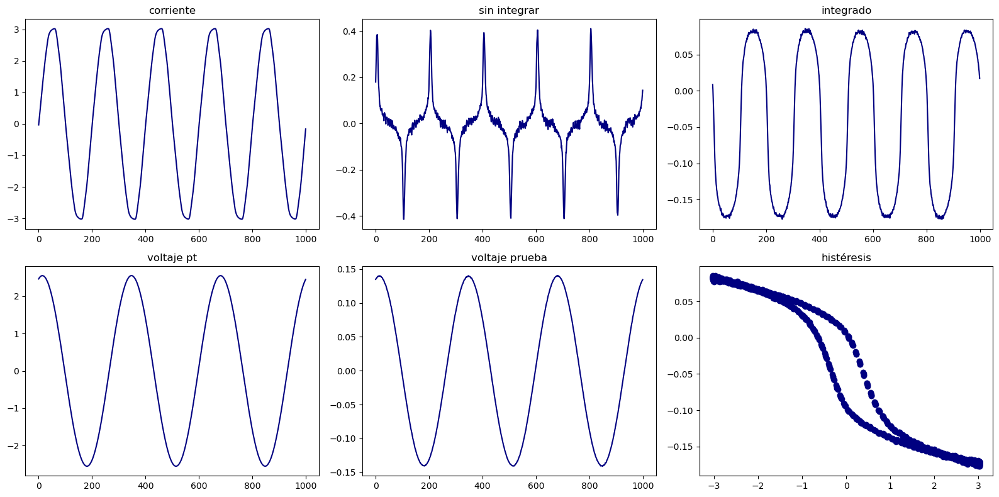

T = 141.82514369486128


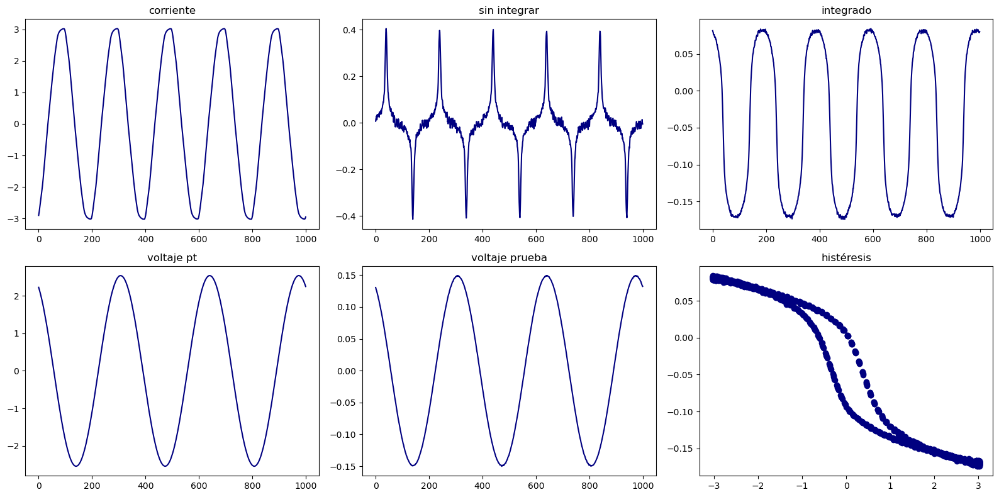

T = 150.3370874853228


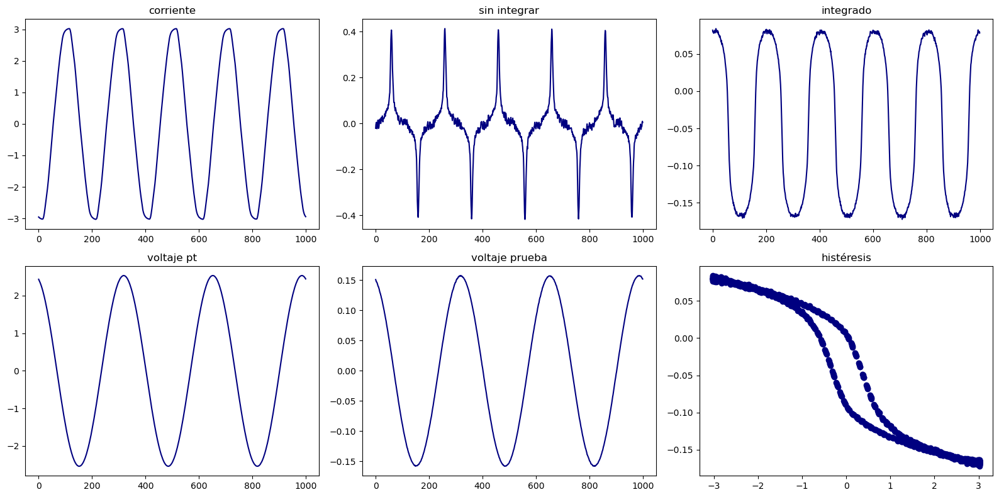

T = 158.37770455033748


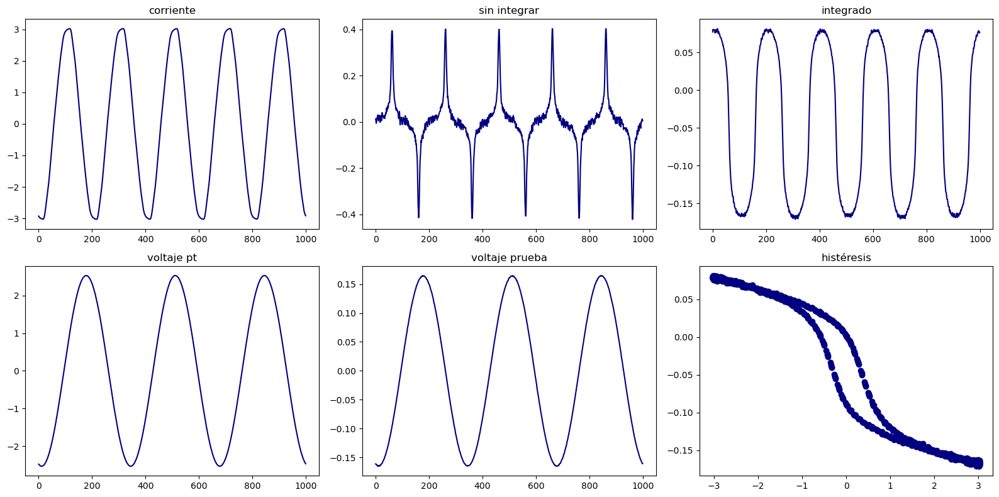

T = 165.47840743729364


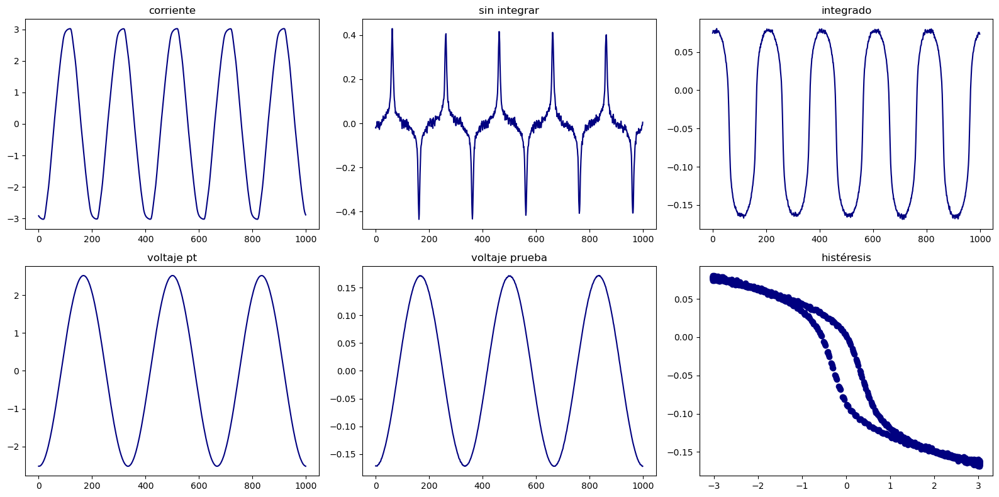

T = 172.29542377749237


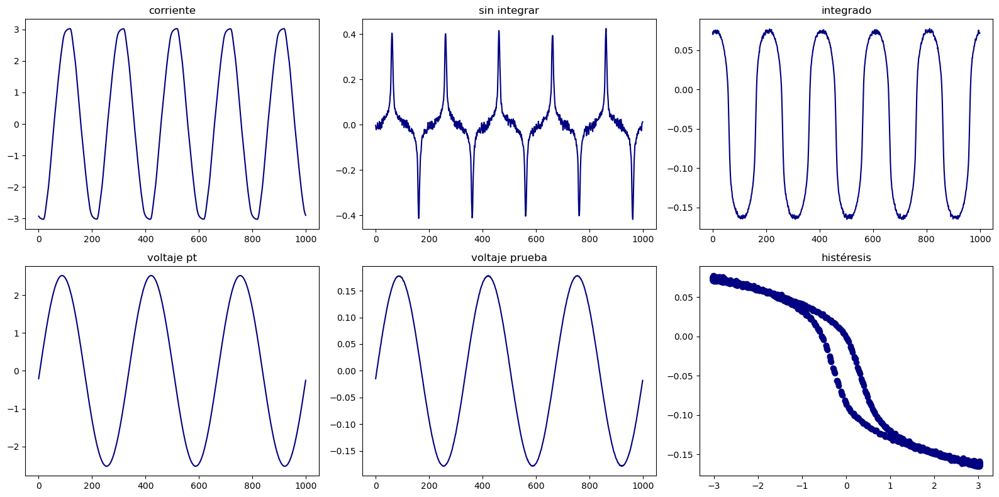

T = 178.63978850456027


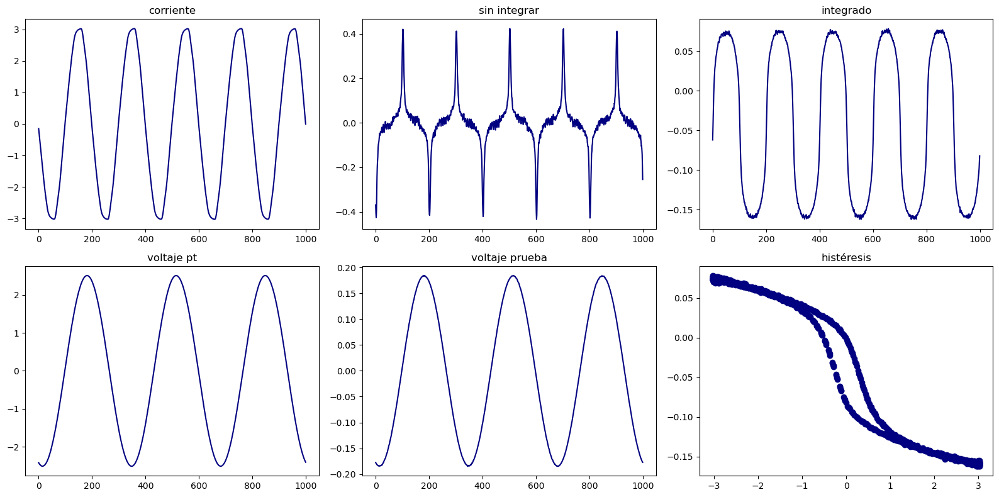

T = 184.856945090087


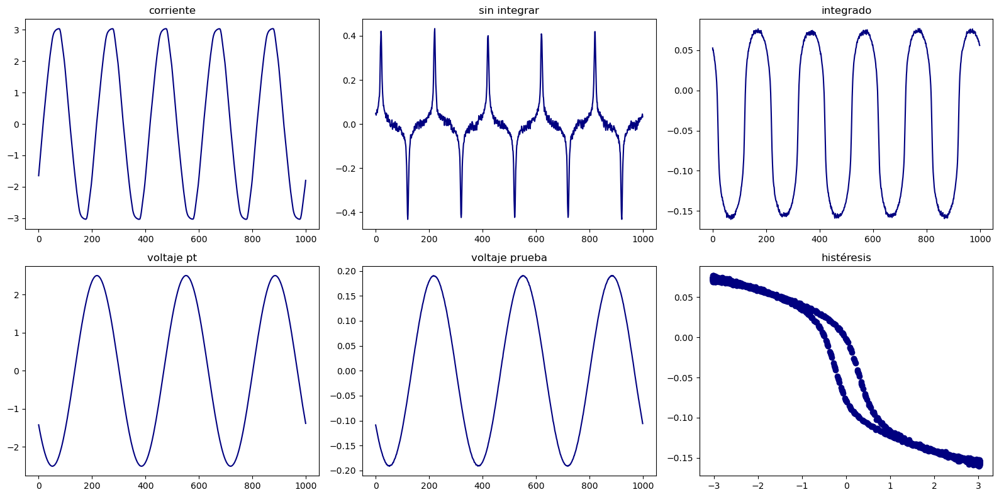

T = 191.1500428390191


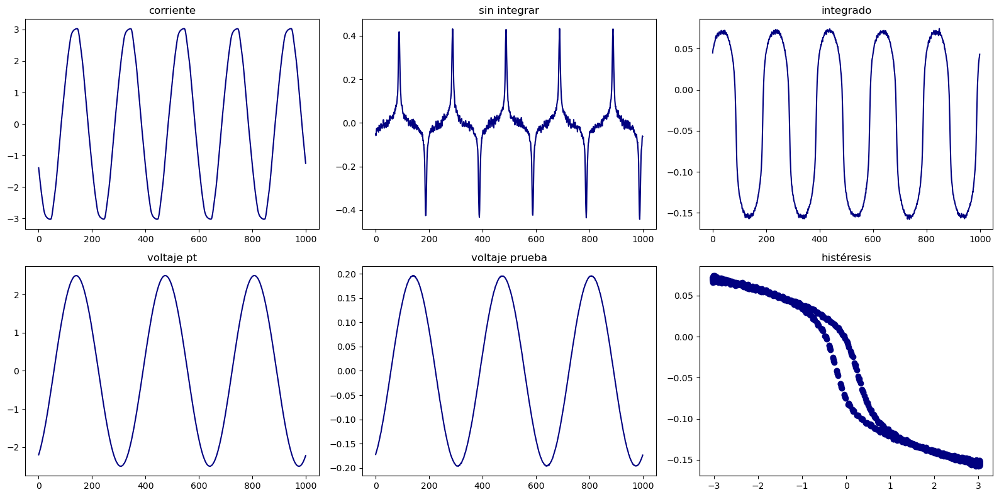

T = 196.42156739611642


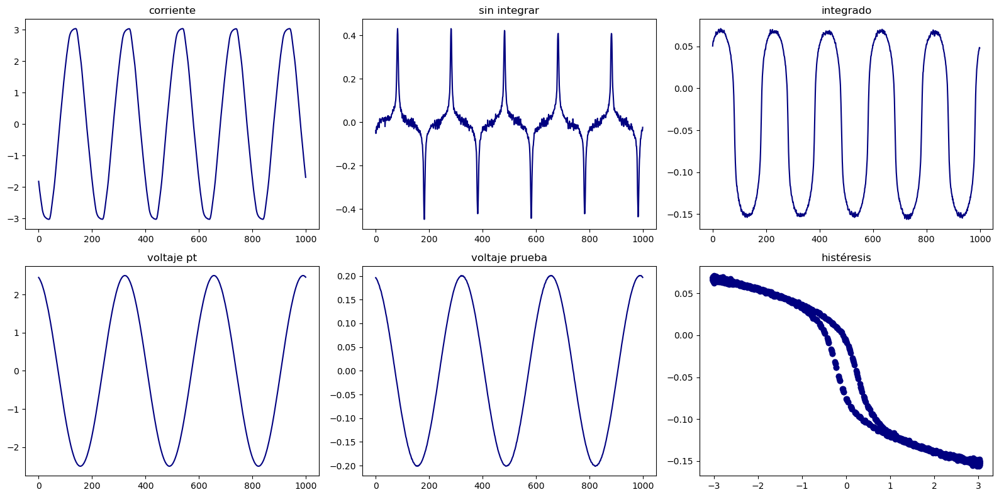

T = 201.47530123433393


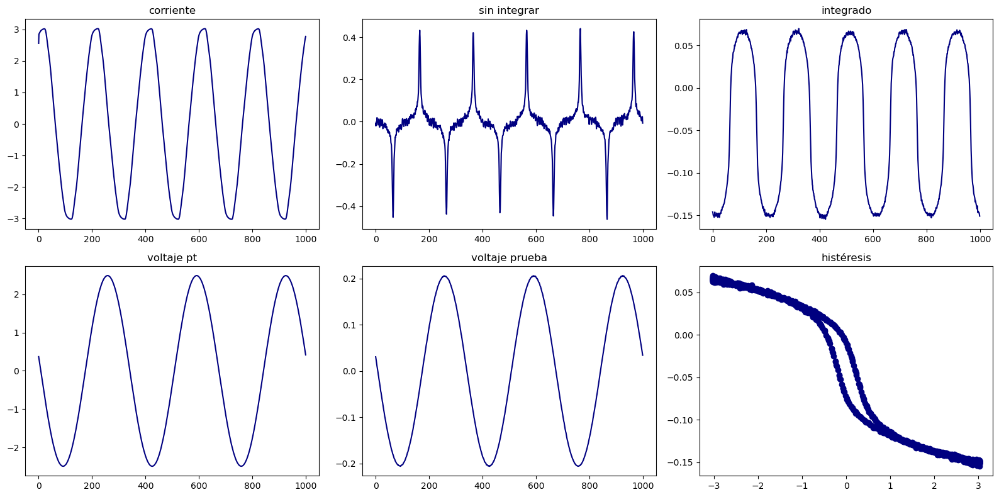

T = 206.42132957430778


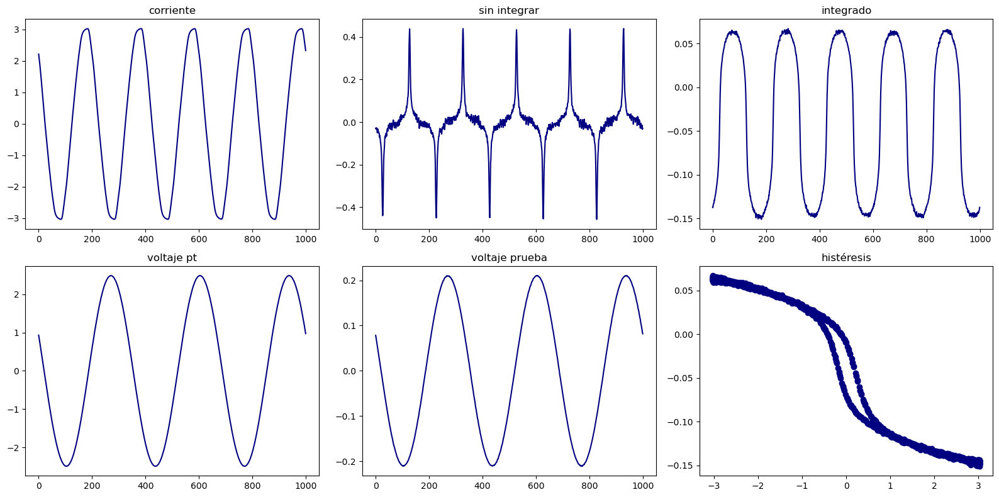

T = 211.02110395490251


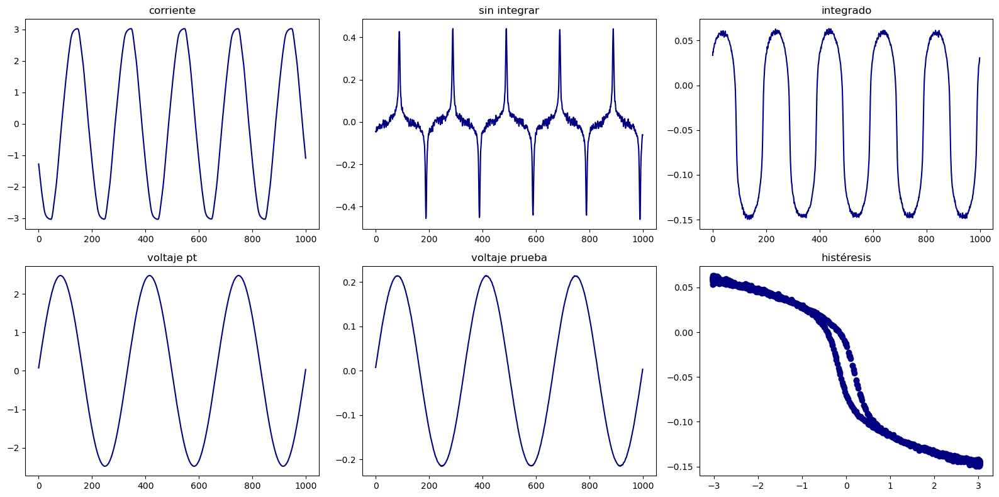

T = 215.39390479057568


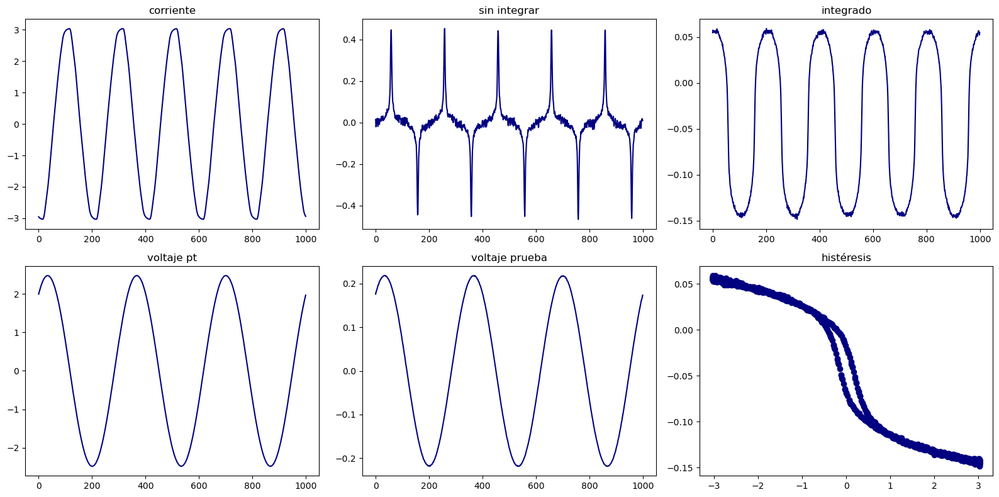

T = 219.3802490882332


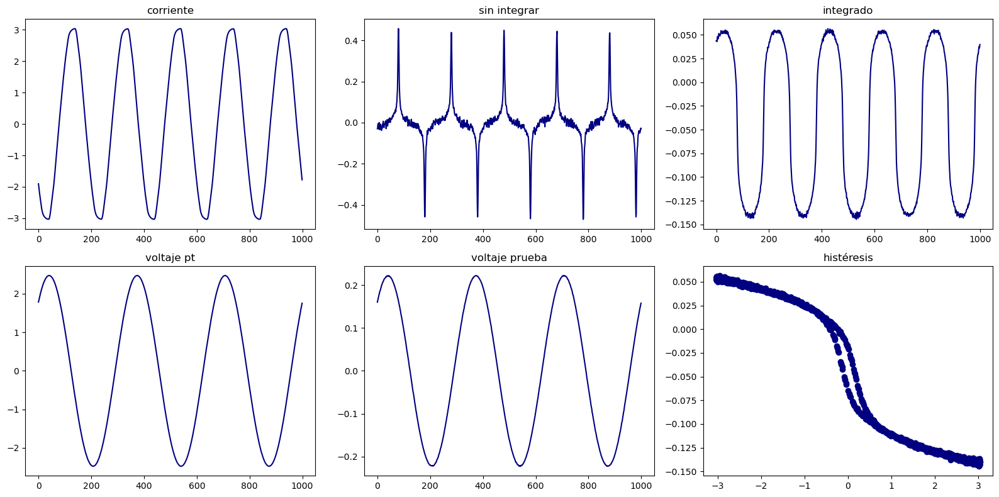

T = 223.0201447299308


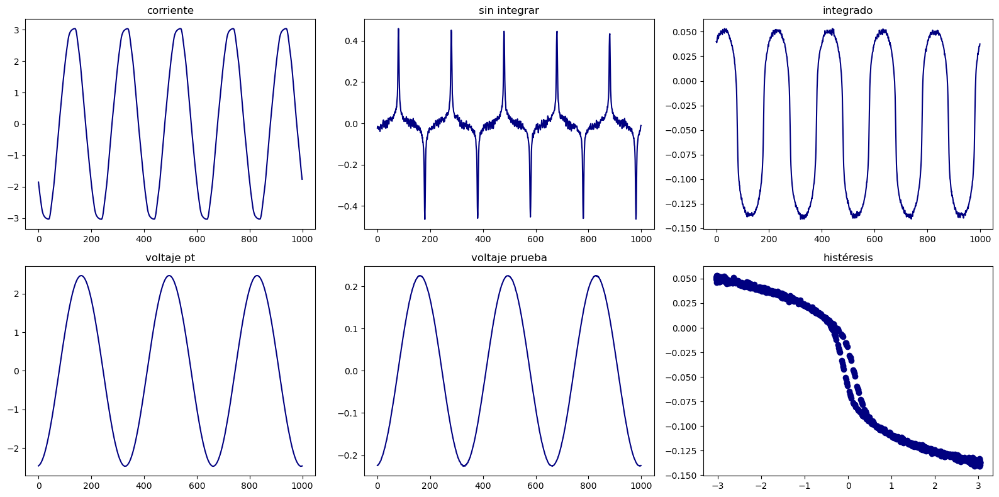

T = 226.4825130072736


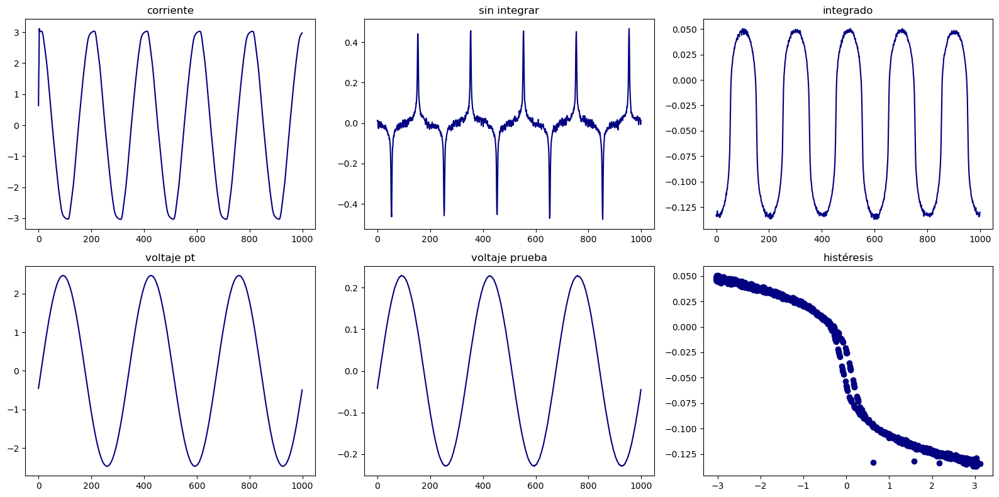

T = 229.71035002426783


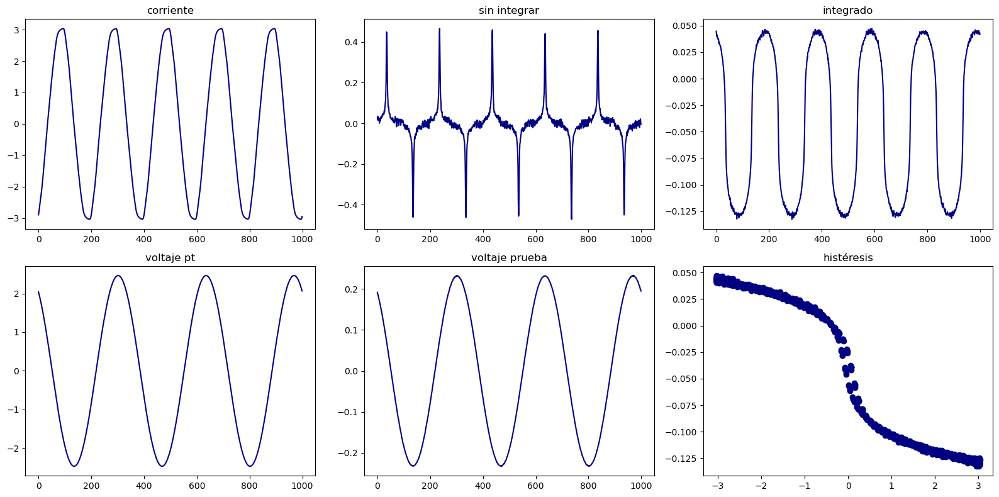

T = 233.10562076298066


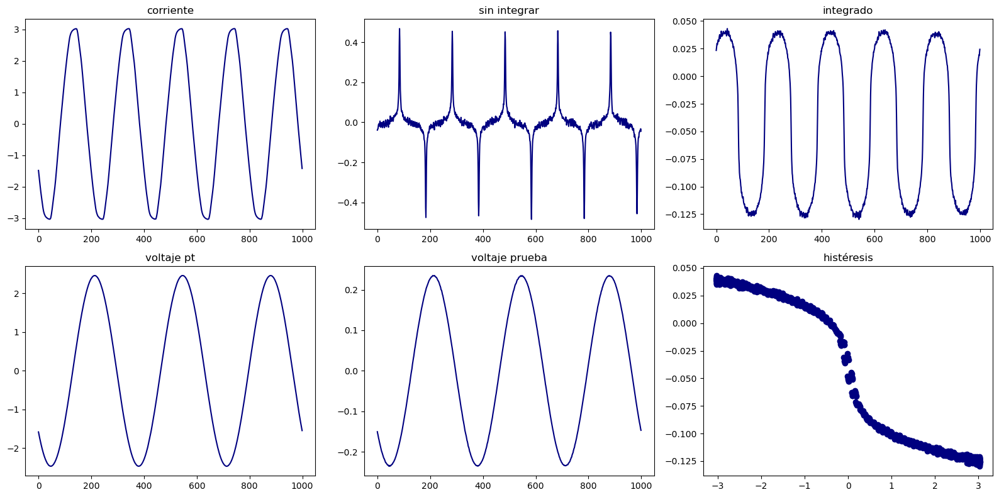

T = 236.06763704994842


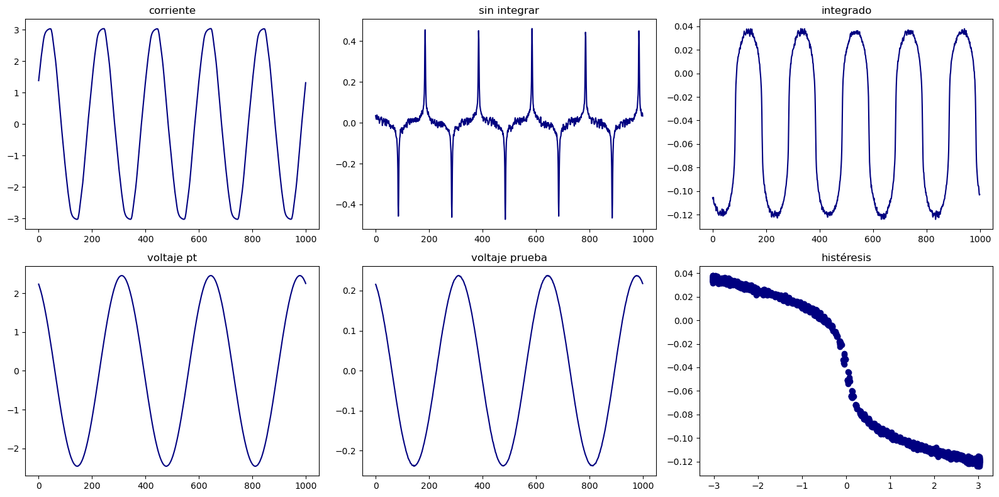

T = 238.93008331637338


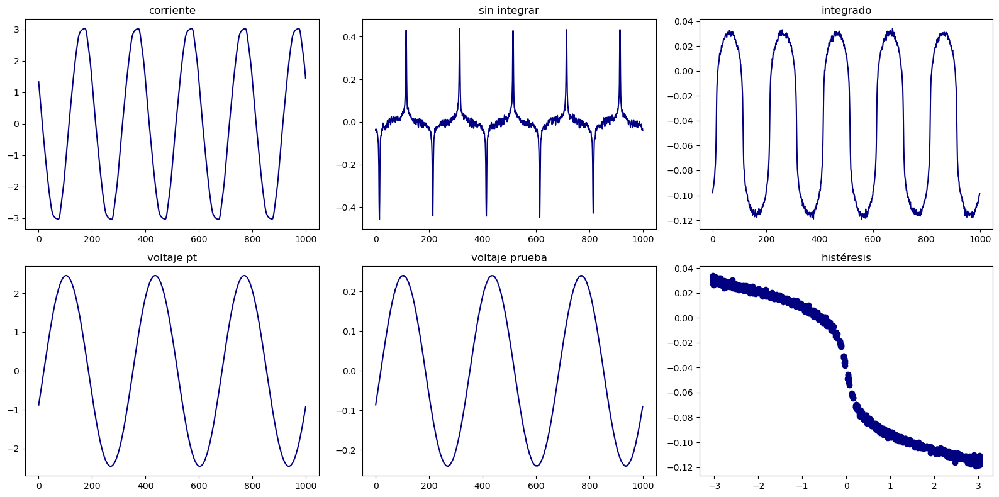

T = 241.6801854489921


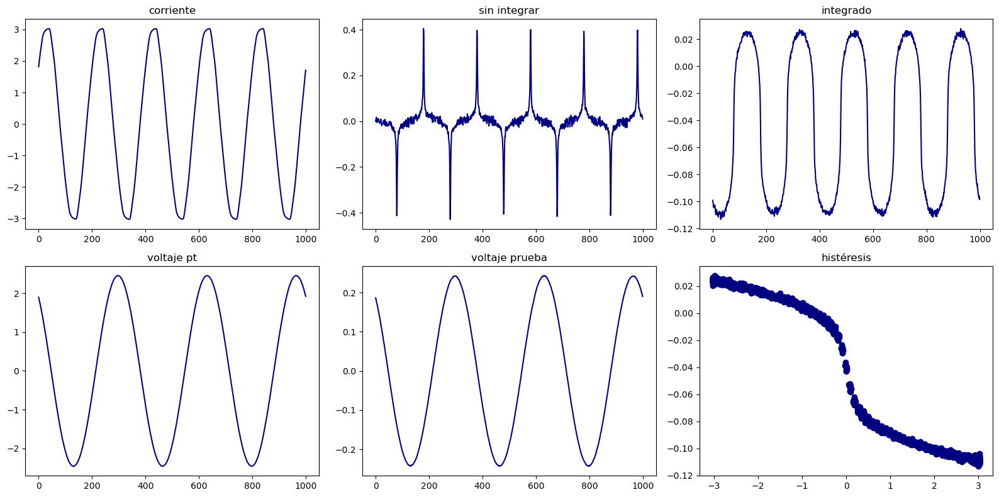

T = 244.25744050118553


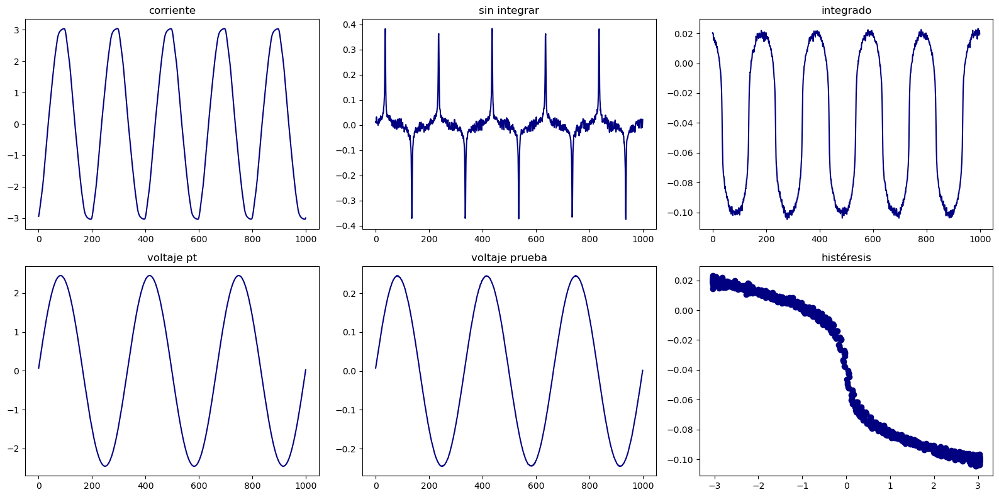

T = 246.75886690834568


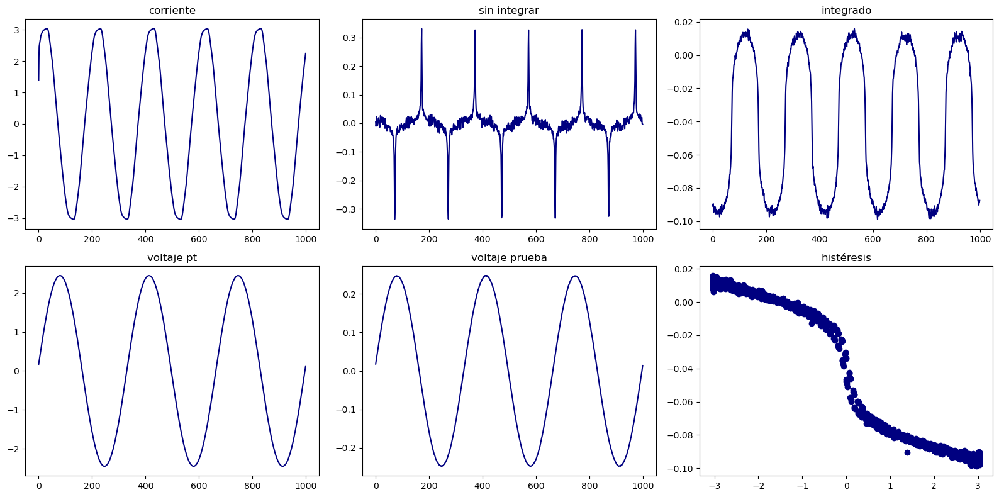

T = 249.0825913506917


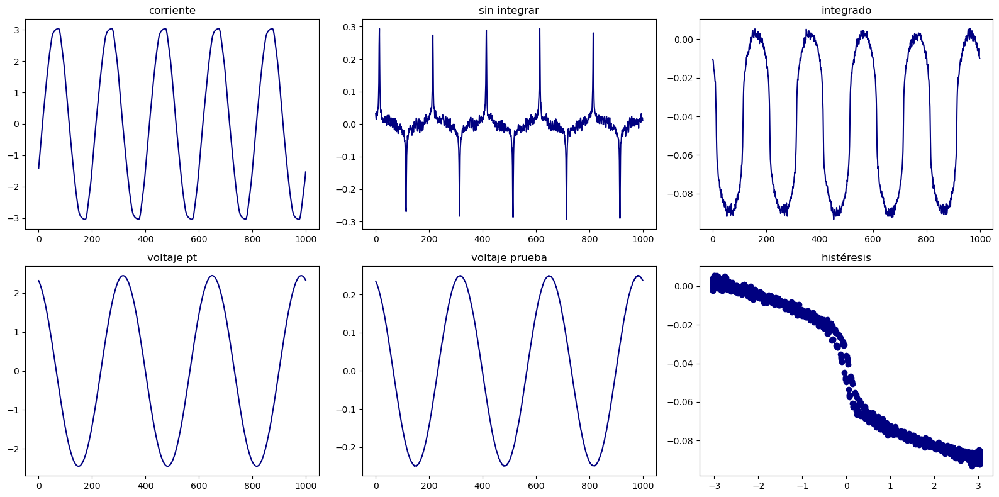

T = 251.18774157369631


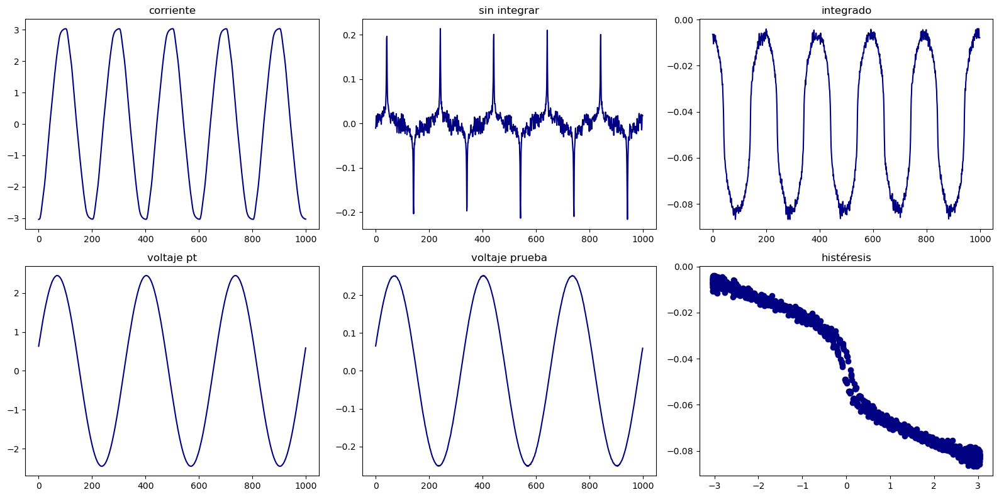

T = 253.2362863410769


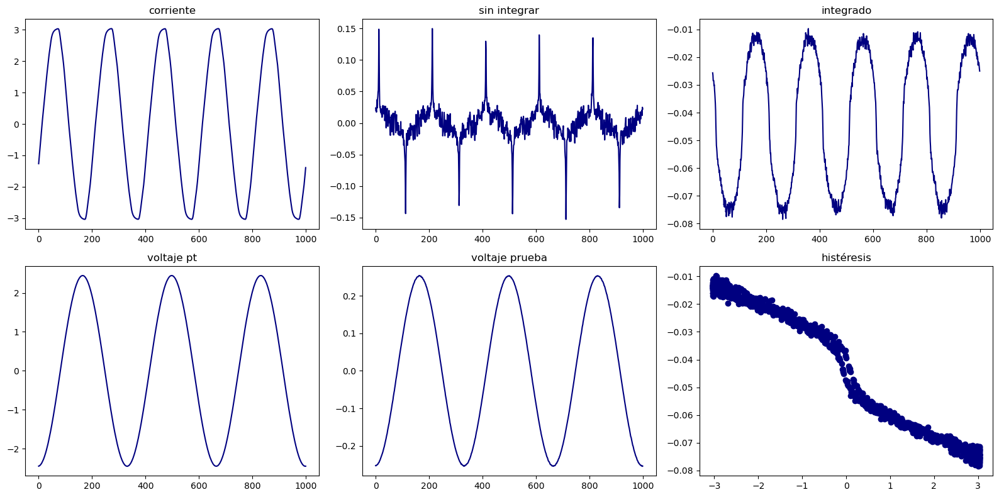

T = 255.1703740782569


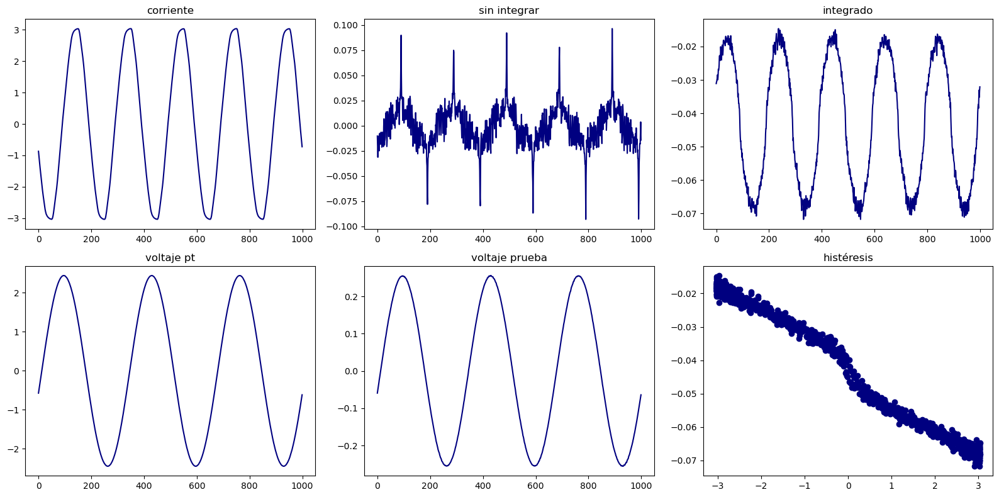

T = 257.37800023588187


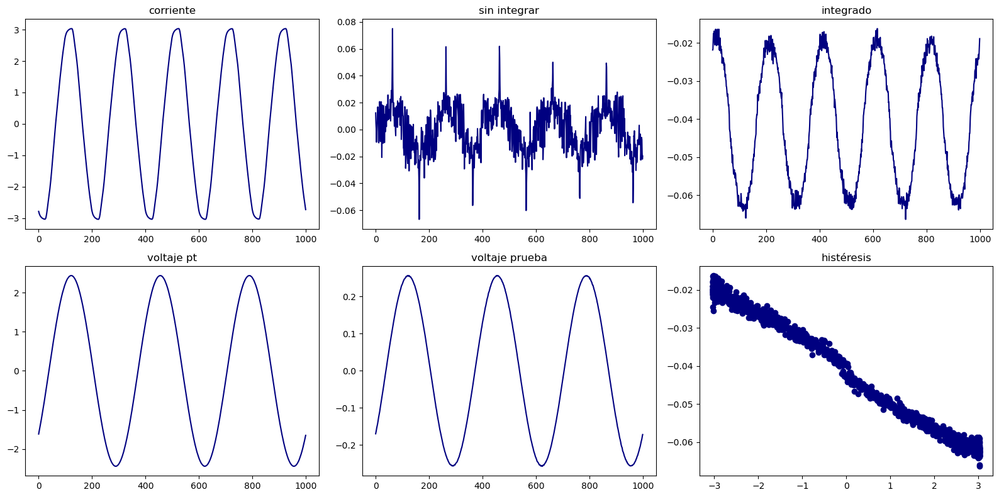

T = 259.02196282815515


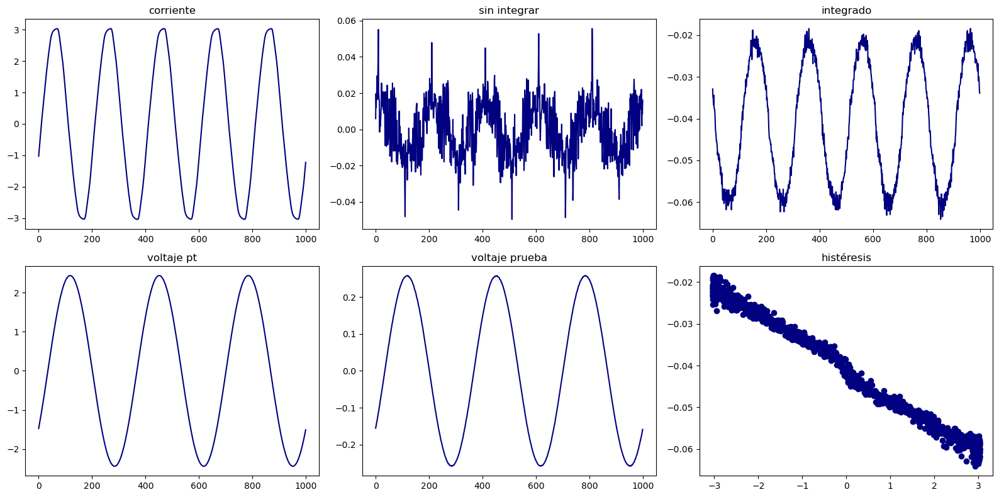

T = 260.4896014848209


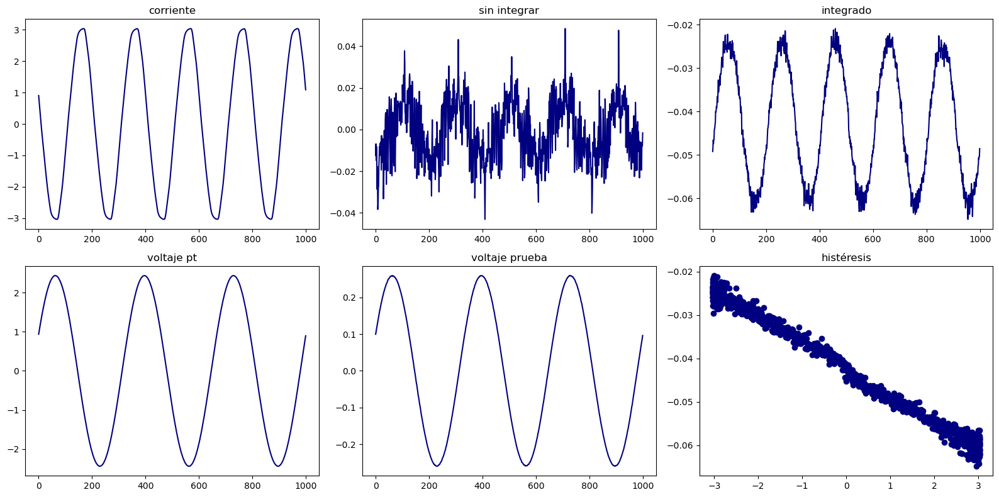

T = 261.8837905714009


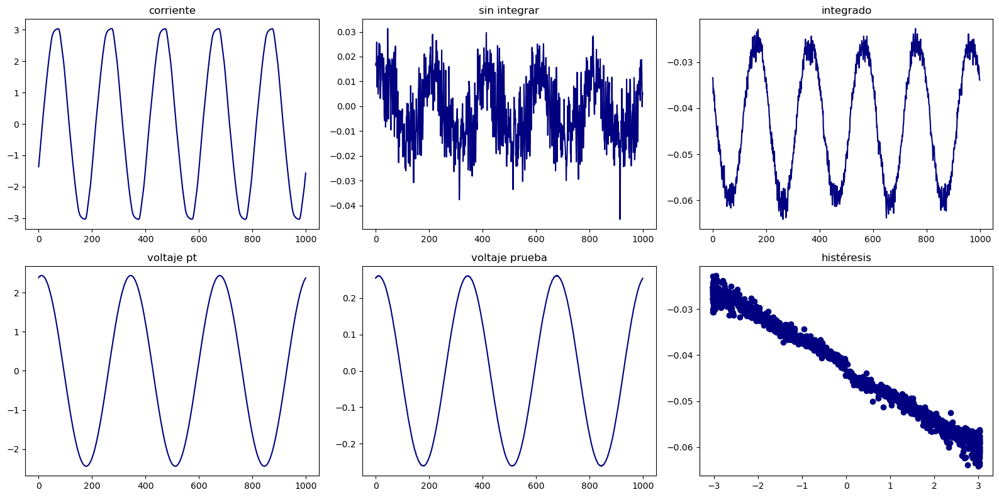

T = 263.25234547031425


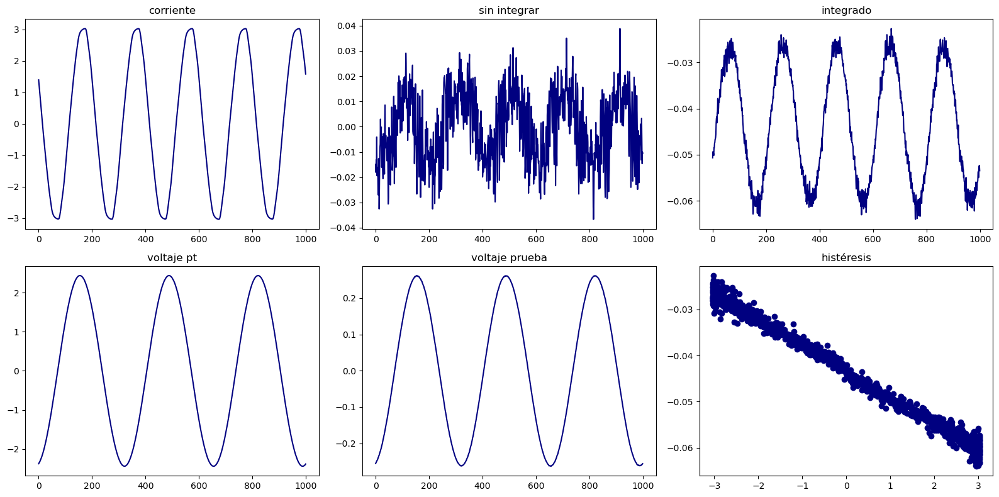

T = 264.68112229852085


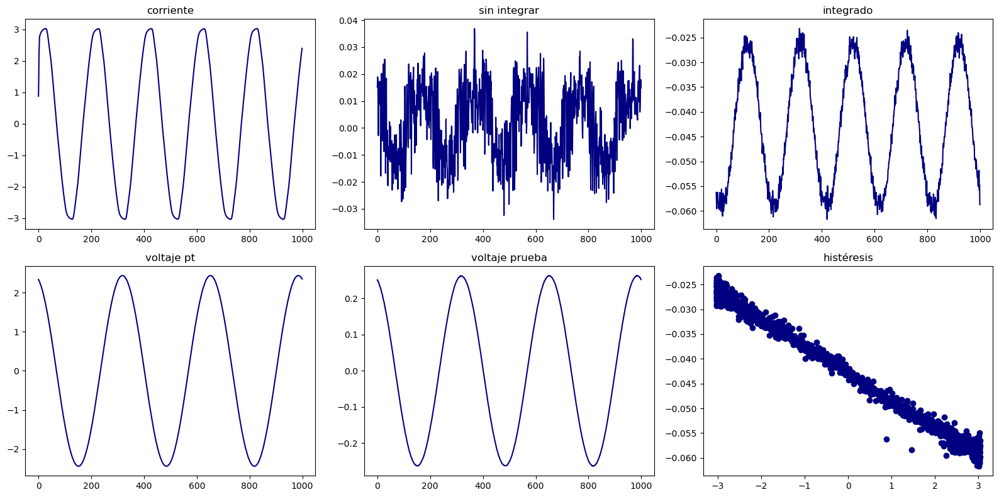

T = 265.6258312363146


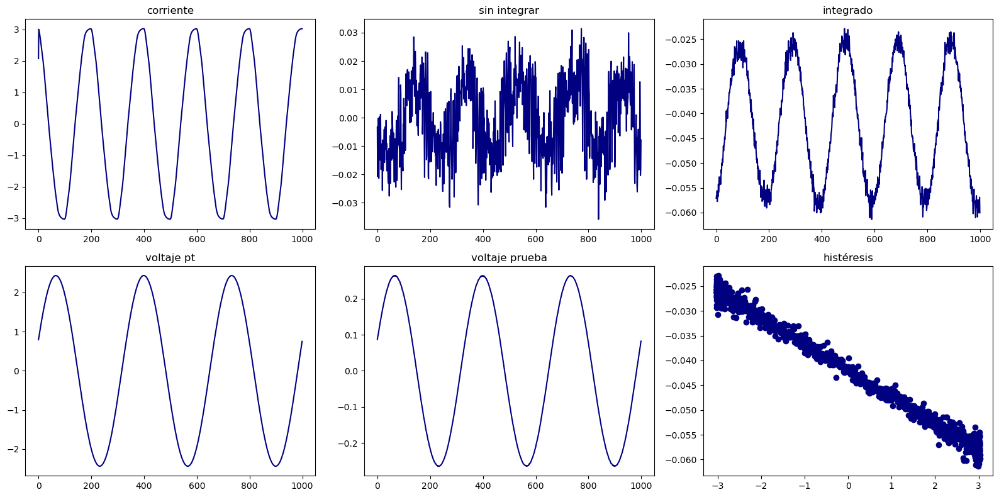

T = 266.6092166809386


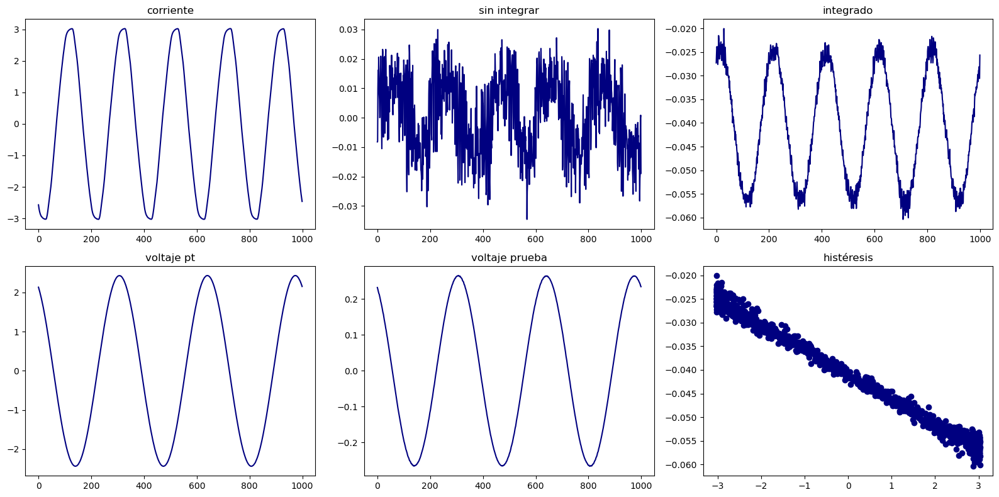

T = 267.60416495505984


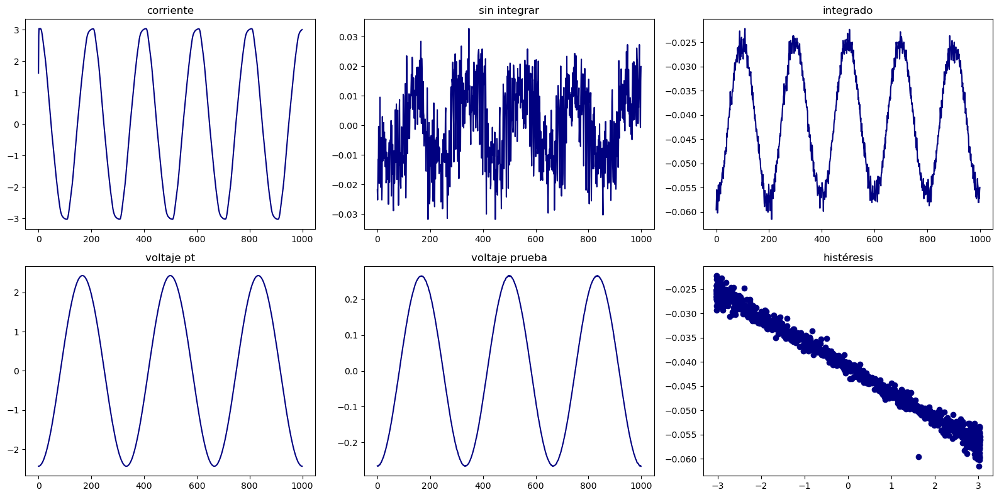

T = 268.351311196759


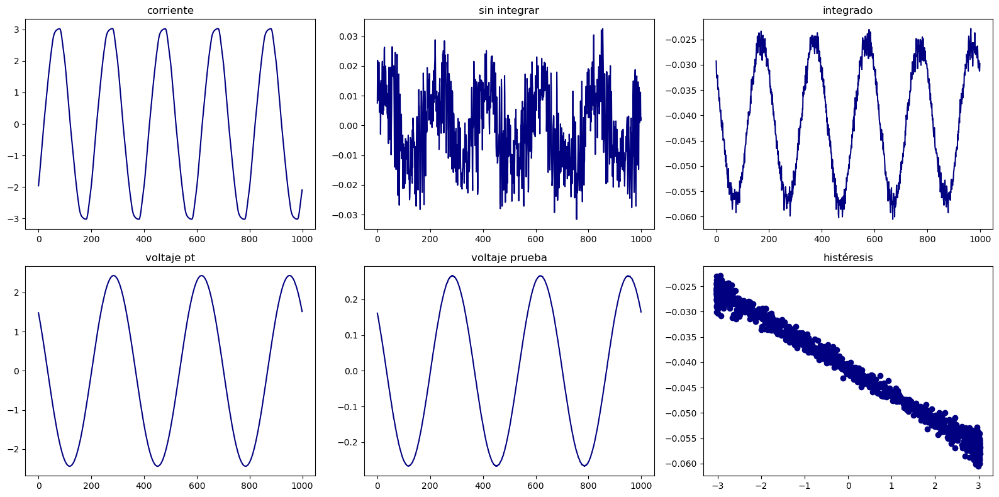

T = 269.05495767345013


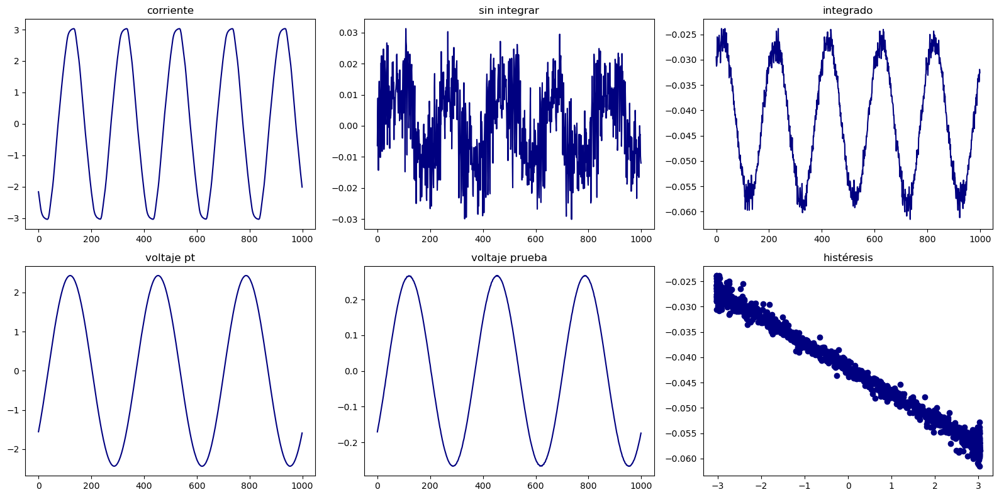

T = 269.83591743751873


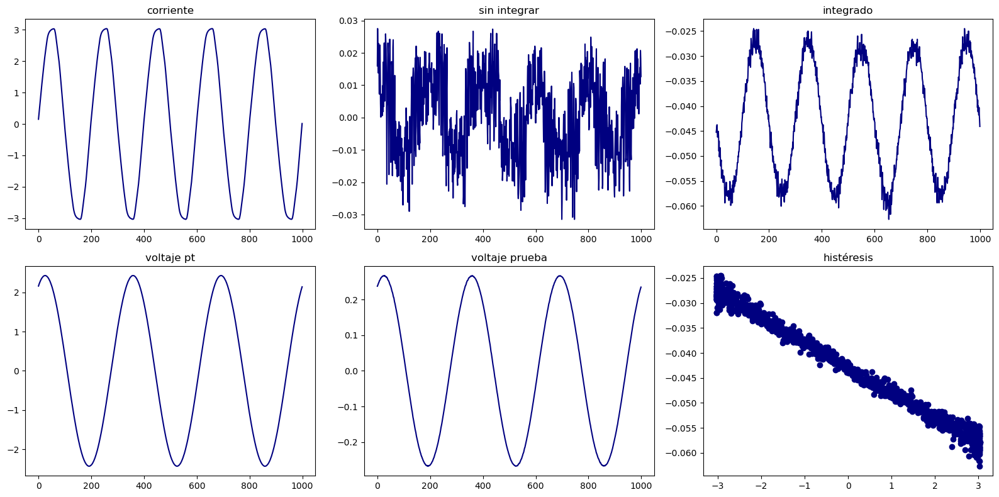

T = 270.43564706320524


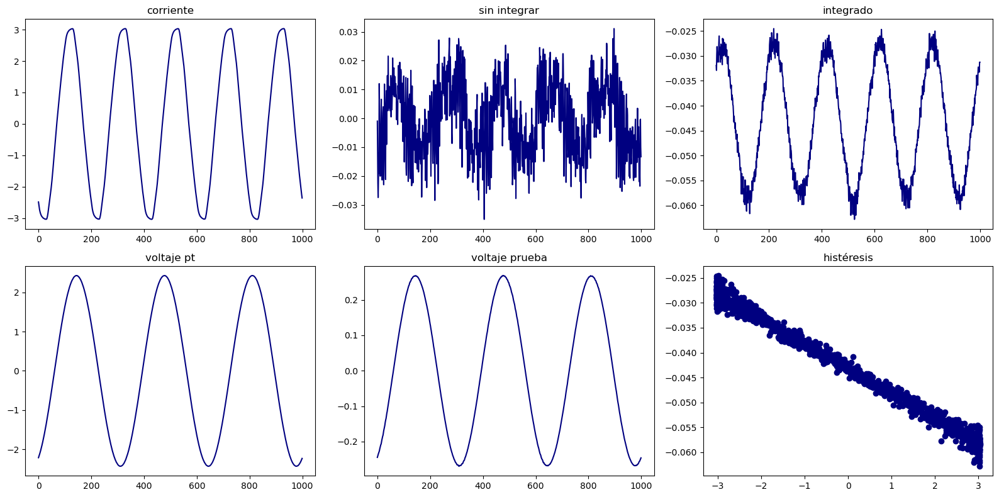

T = 270.9971242698587


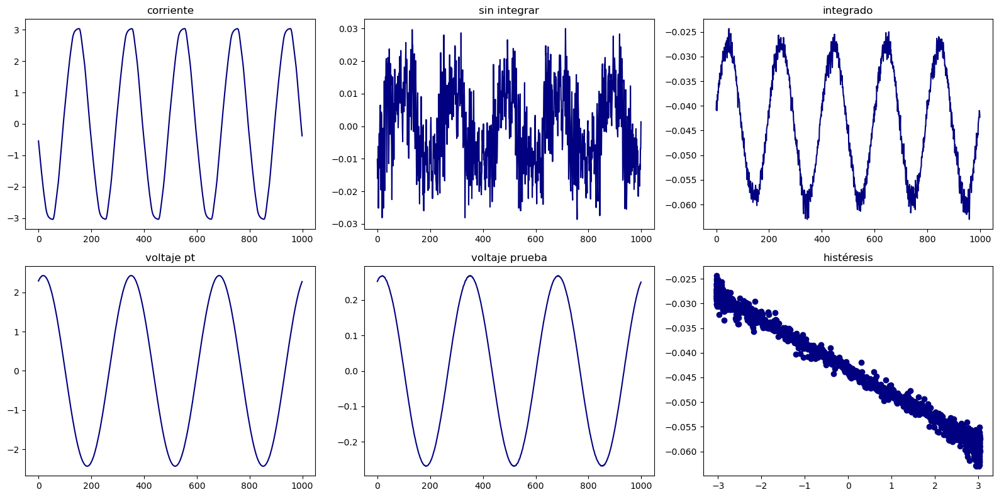

T = 271.3801119792266


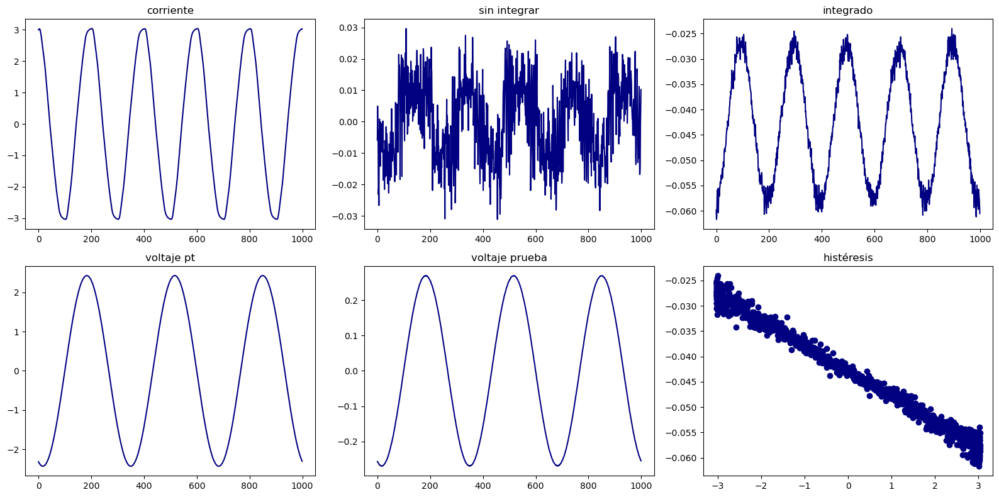

T = 271.8526027533052


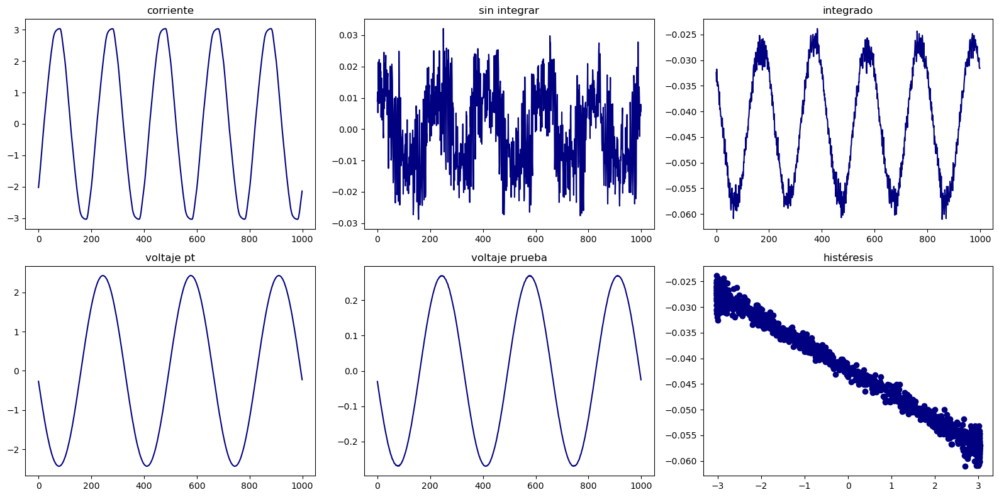

T = 272.6399620753948


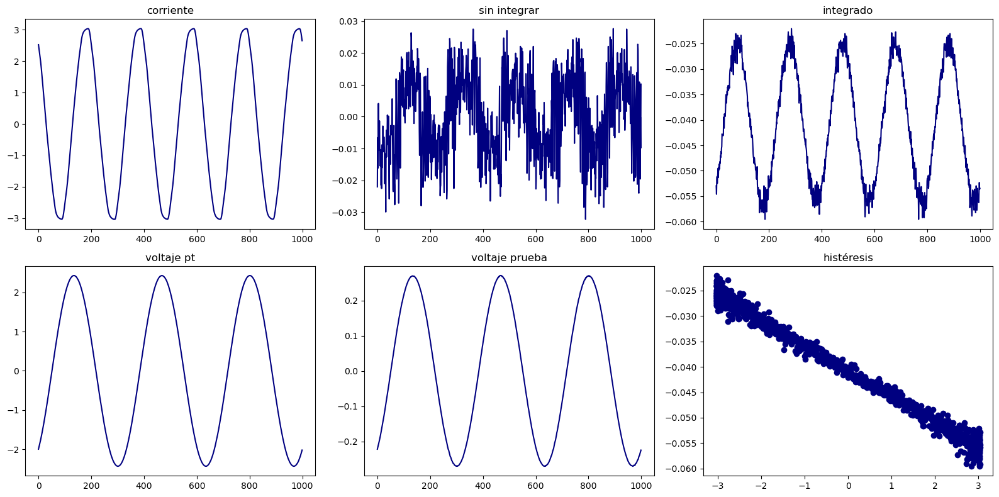

T = 273.50421981630024


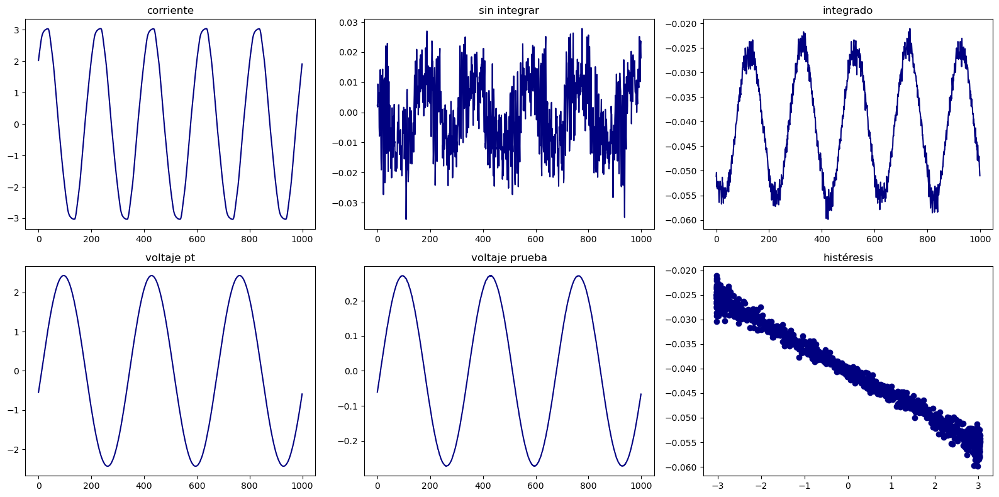

T = 274.51431937024466


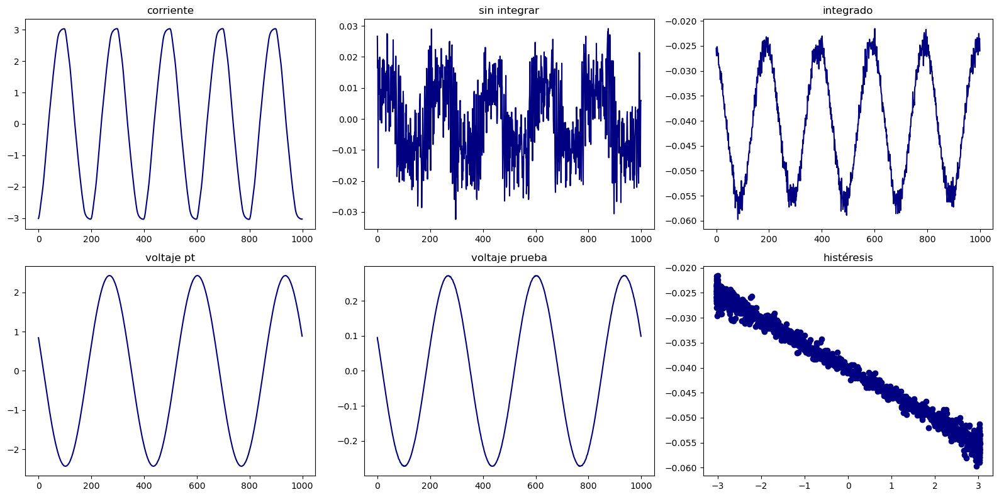

T = 275.5294063731652


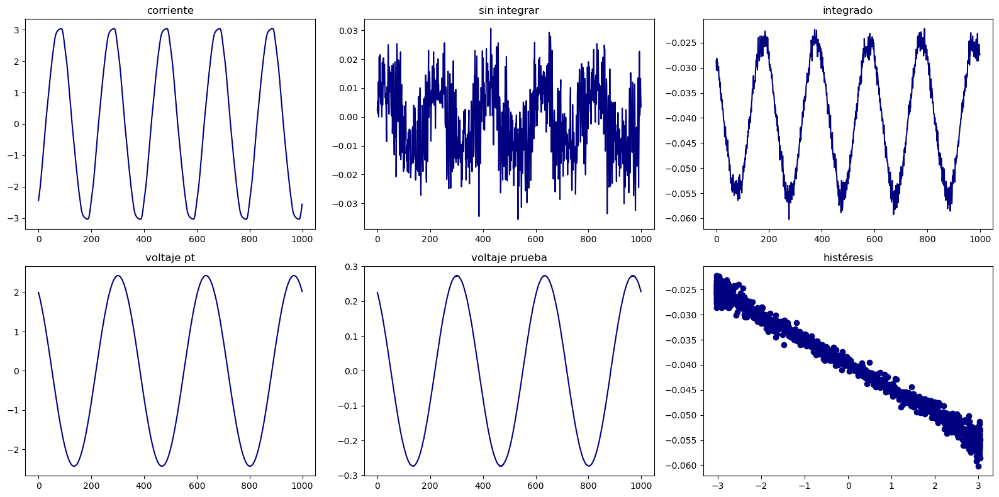

T = 276.81751880028304


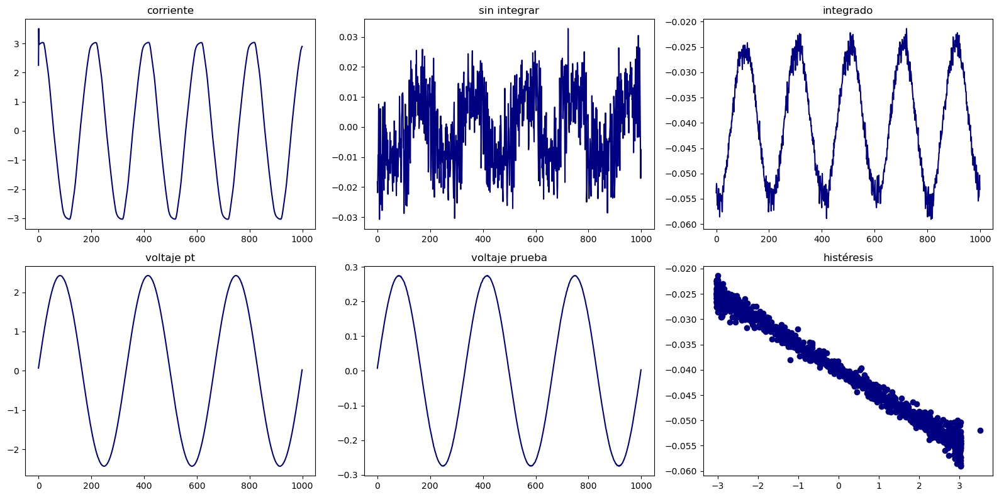

T = 277.7615904098503


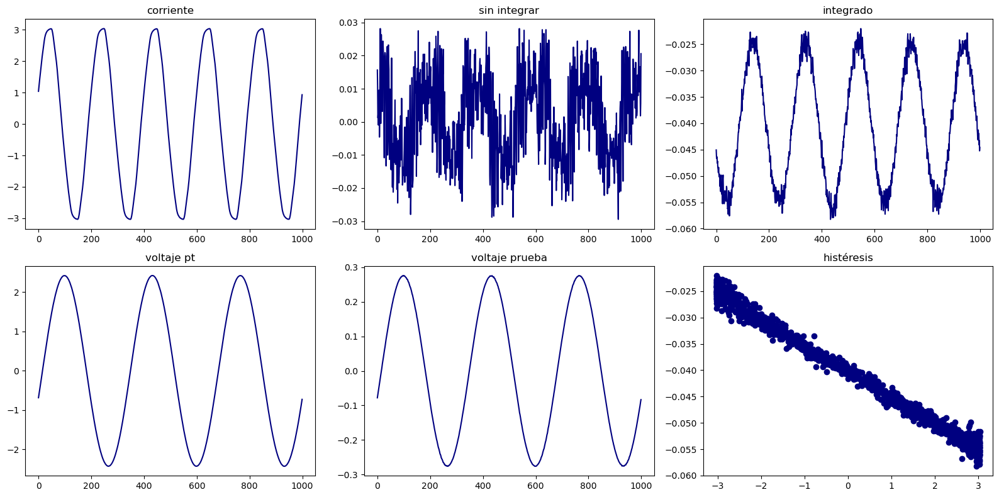

T = 278.753159364393


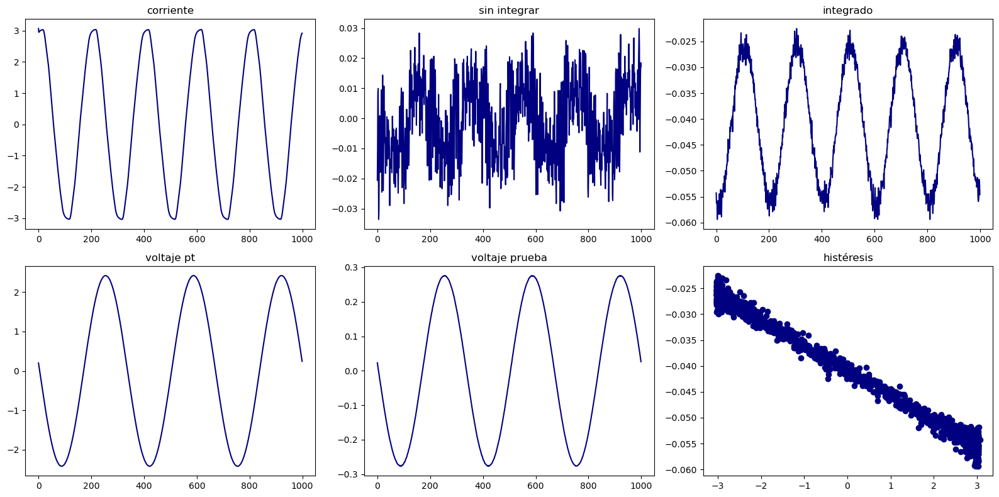

T = 279.70456487974457


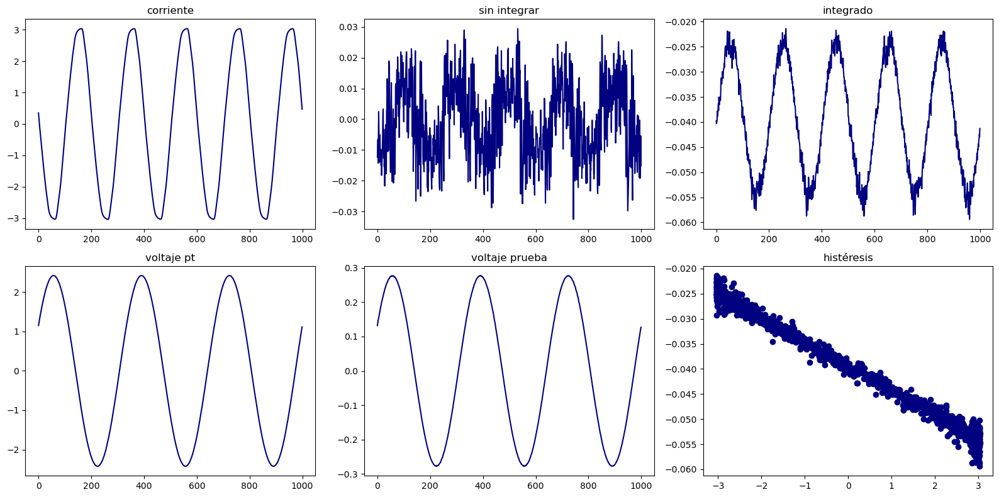

T = 280.4995337653453


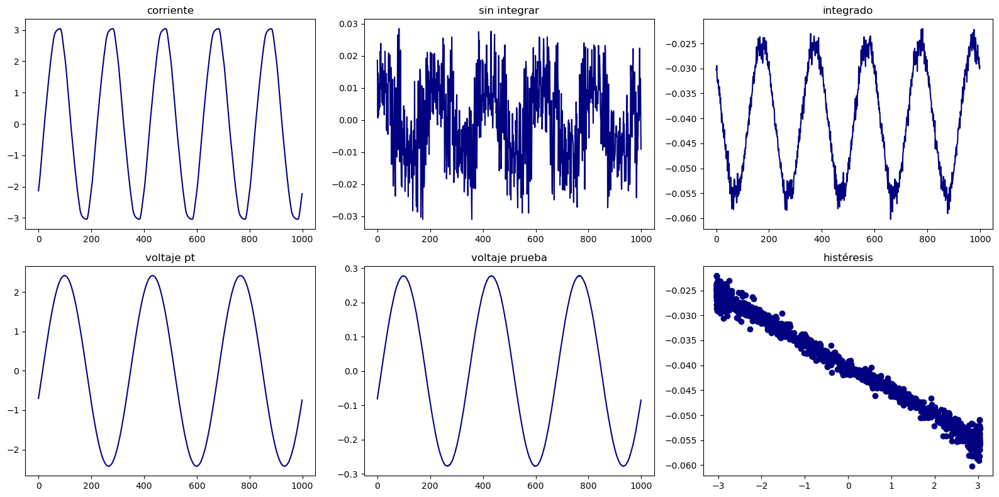

T = 281.2573135458781


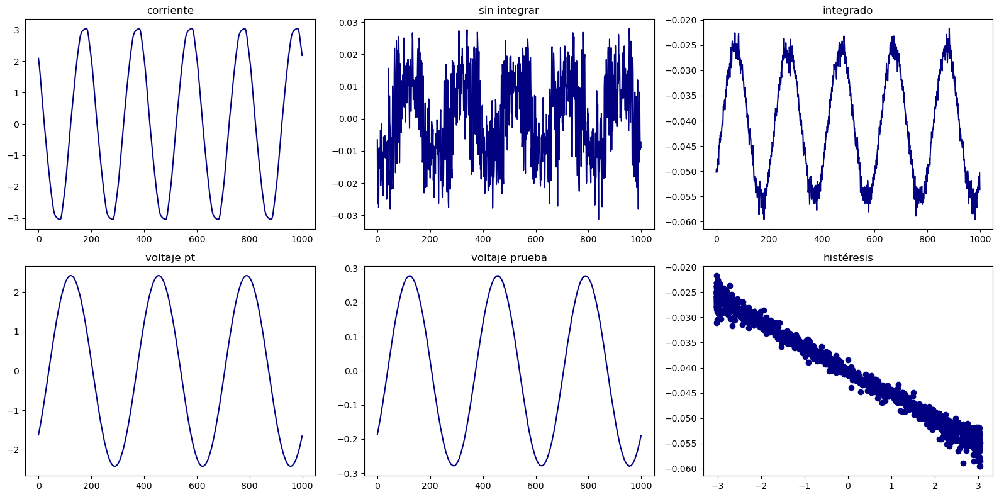

T = 282.03118870590373


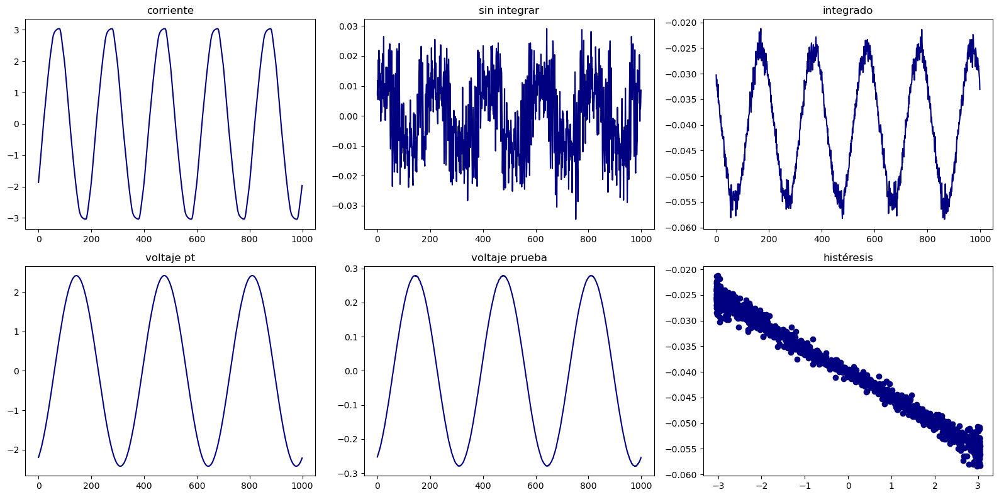

T = 282.6422215209798


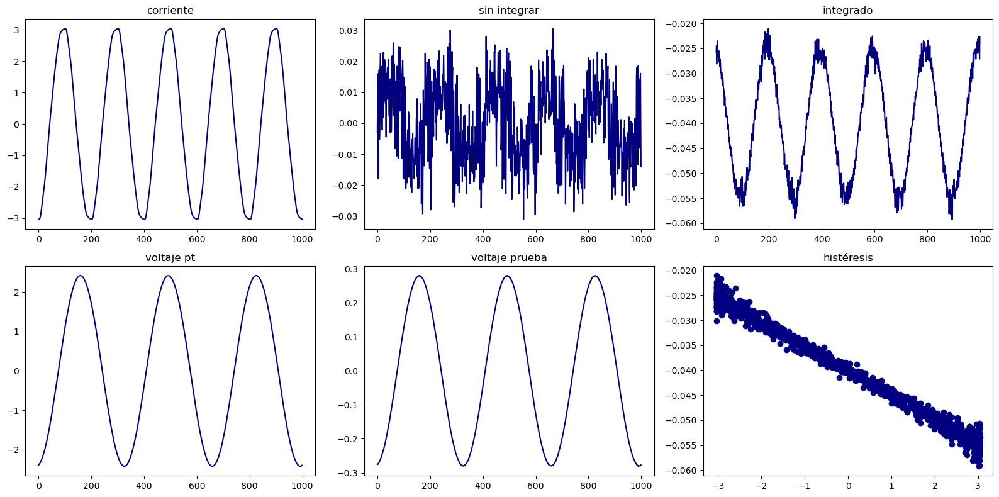

T = 283.25323462749566


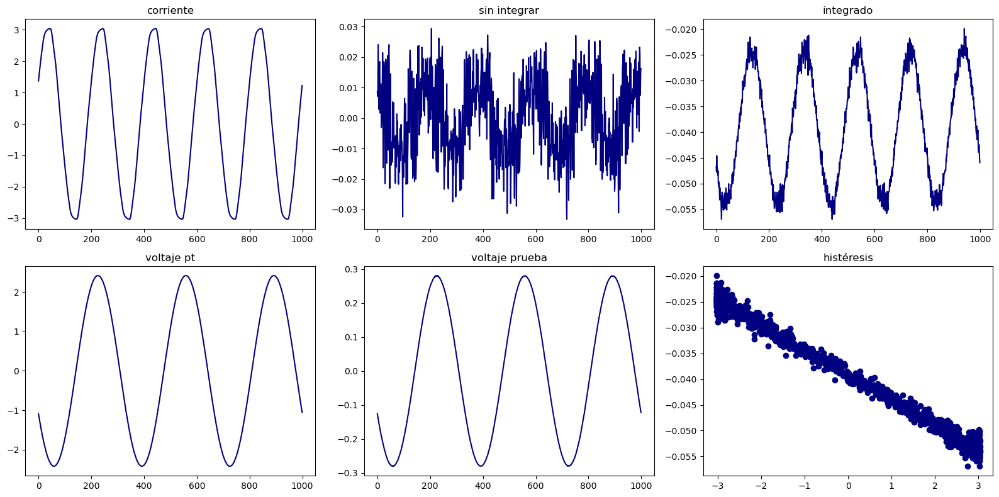

T = 283.8496255577552


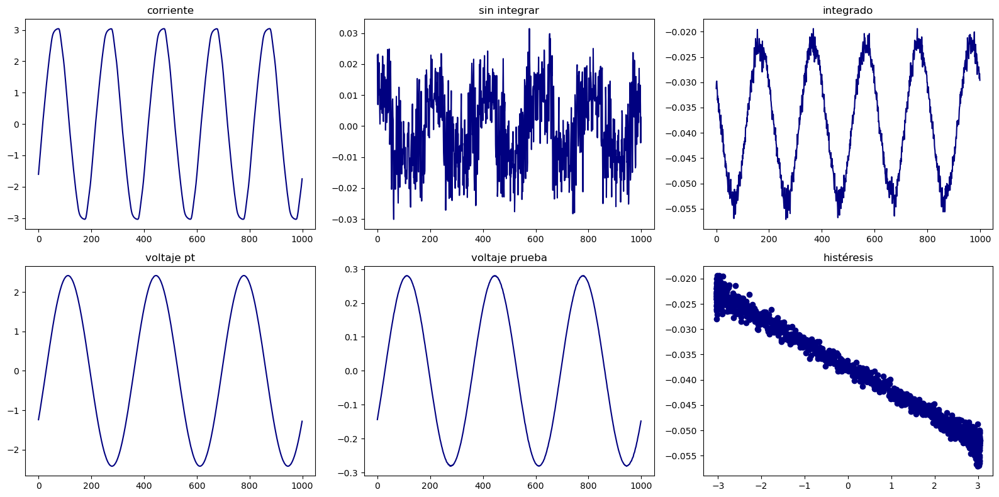

T = 284.45371554188705


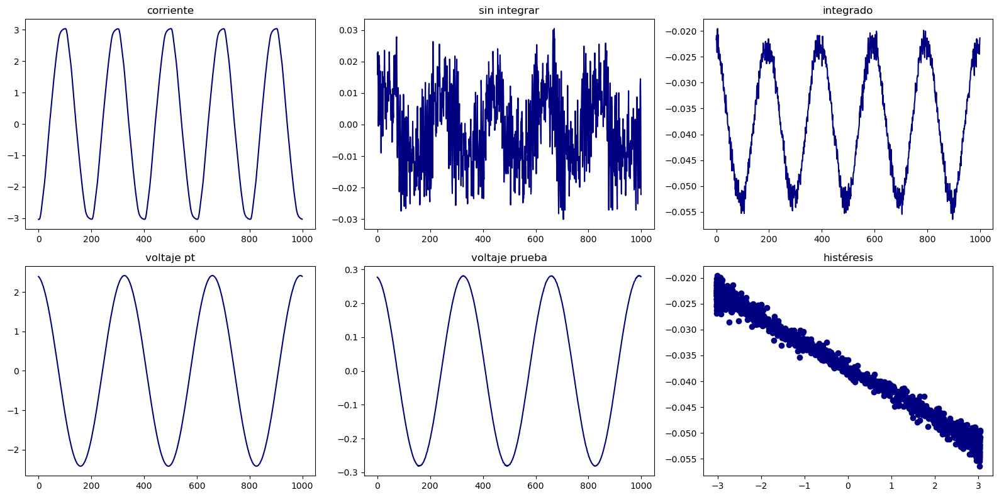

T = 285.02201236416823


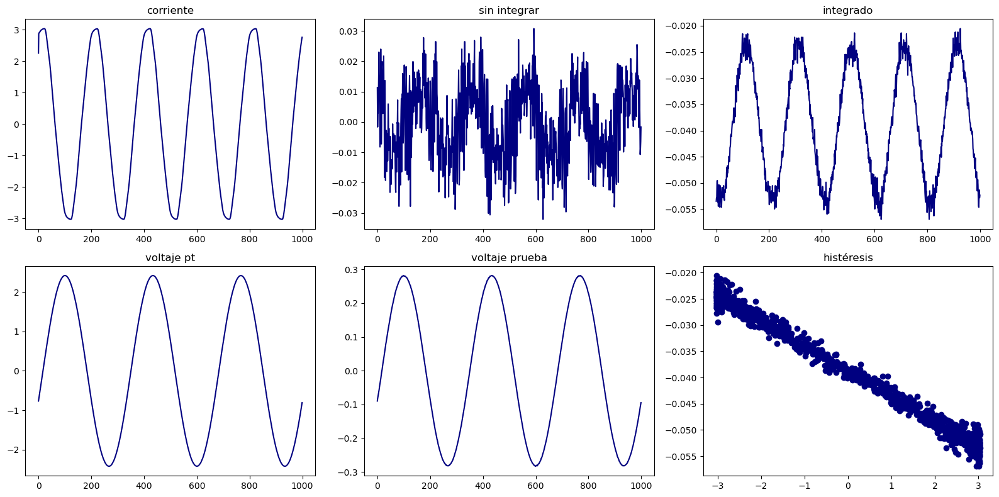

T = 285.3864843428007


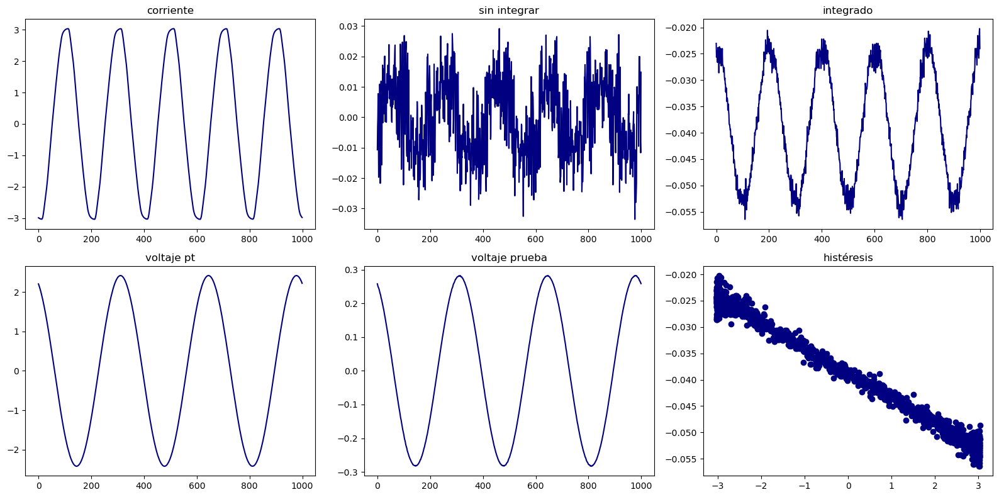

T = 285.90454604790847


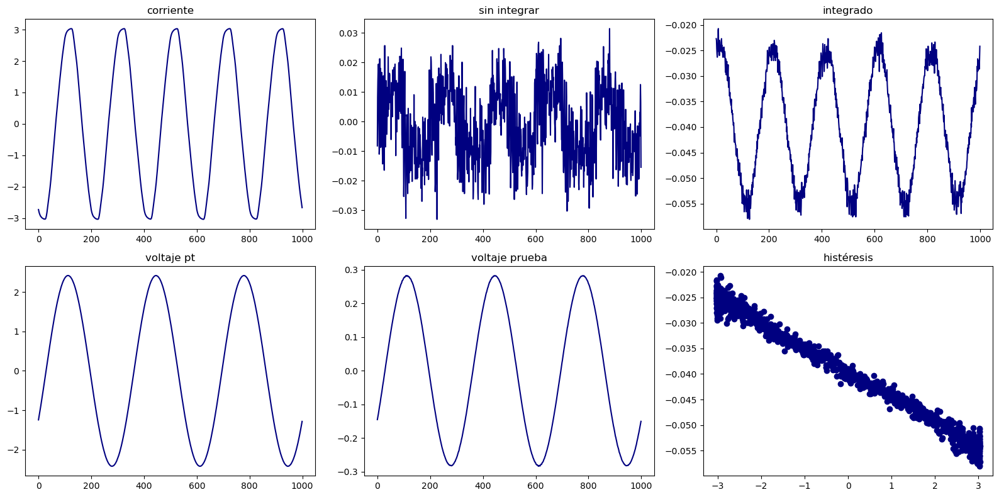

T = 286.2583346679056


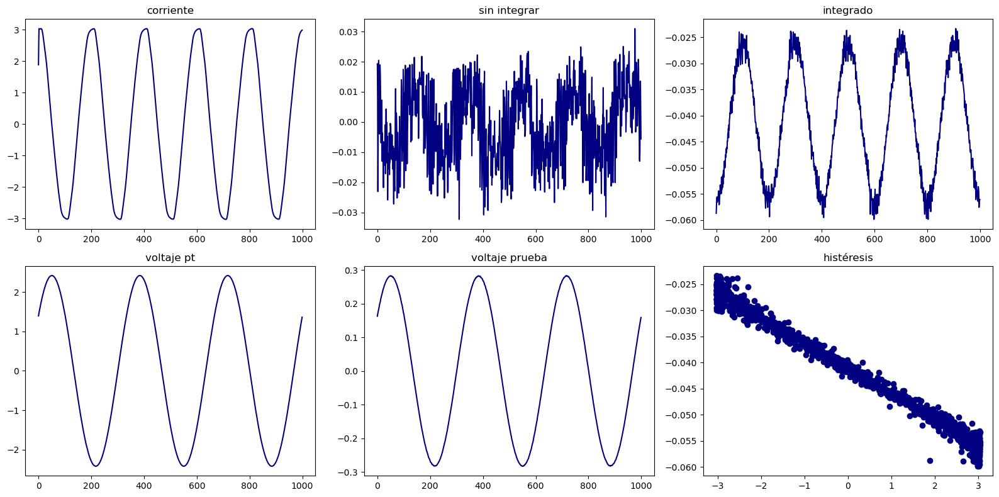

T = 286.5526629299608


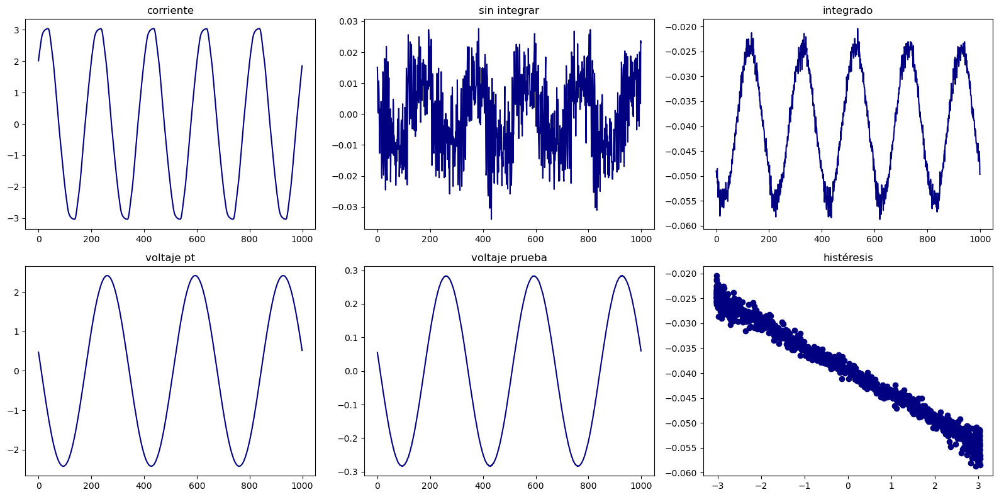

T = 287.0786734860852


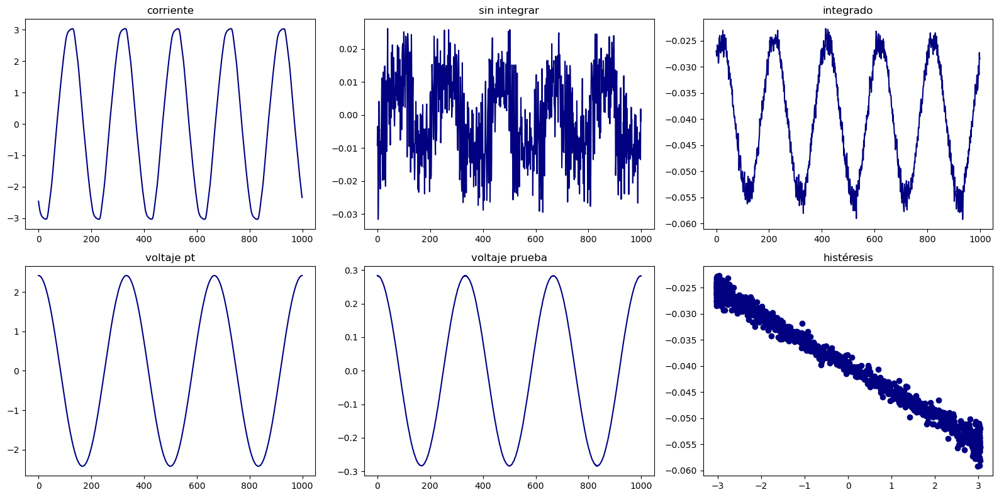

T = 287.374356526368


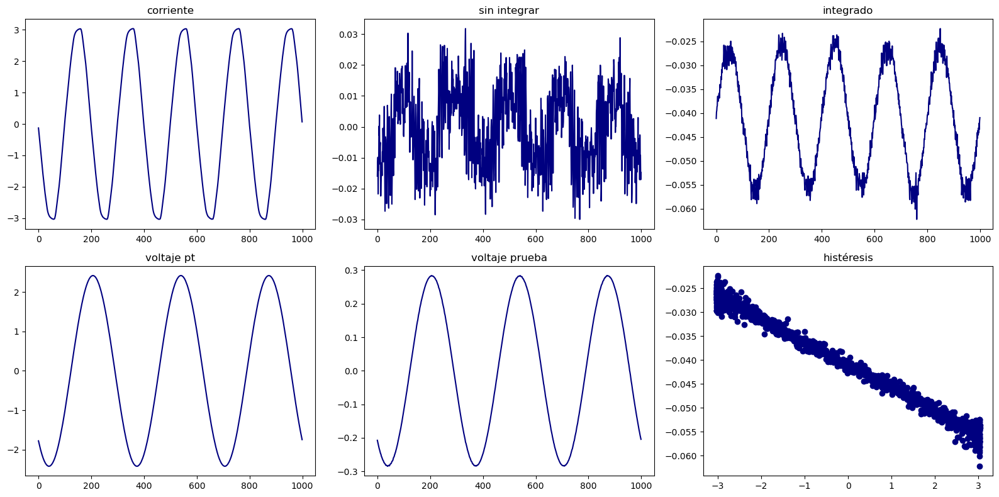

T = 287.56426384747544


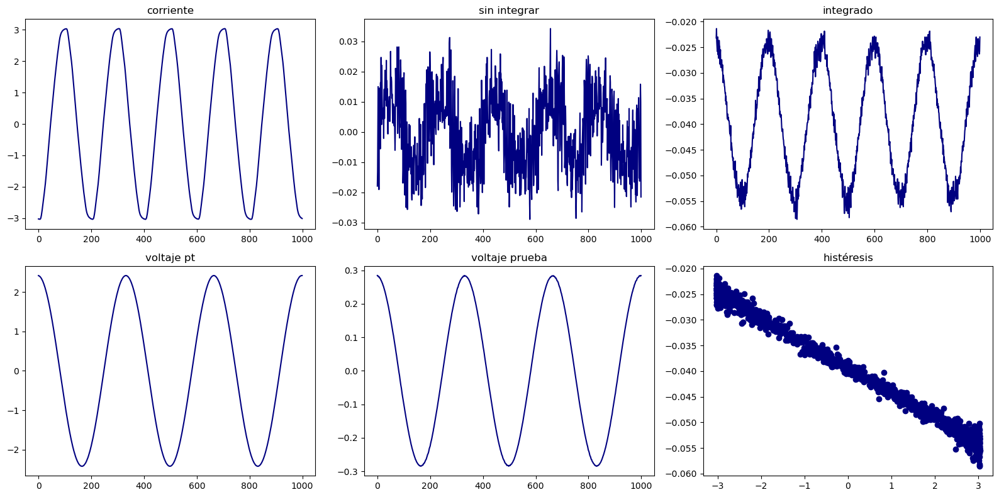

T = 287.98885222567884


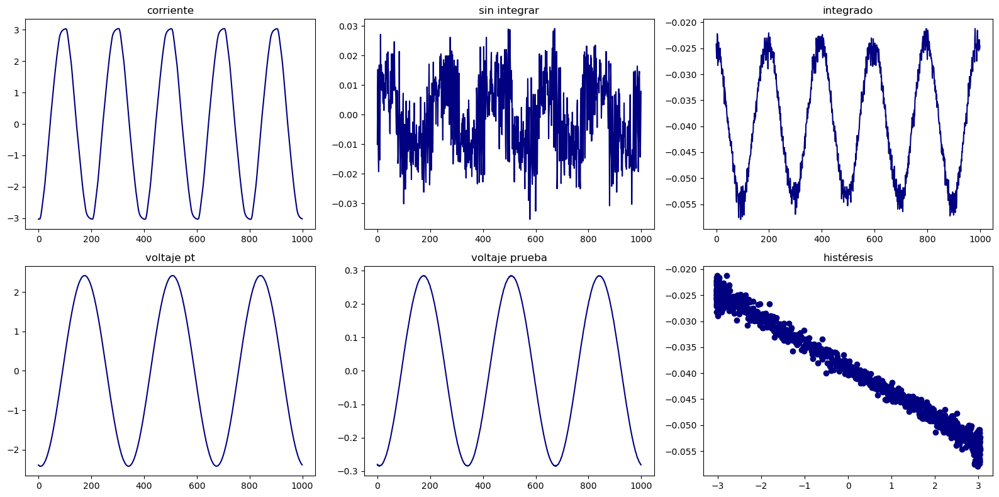

T = 288.29834215711173


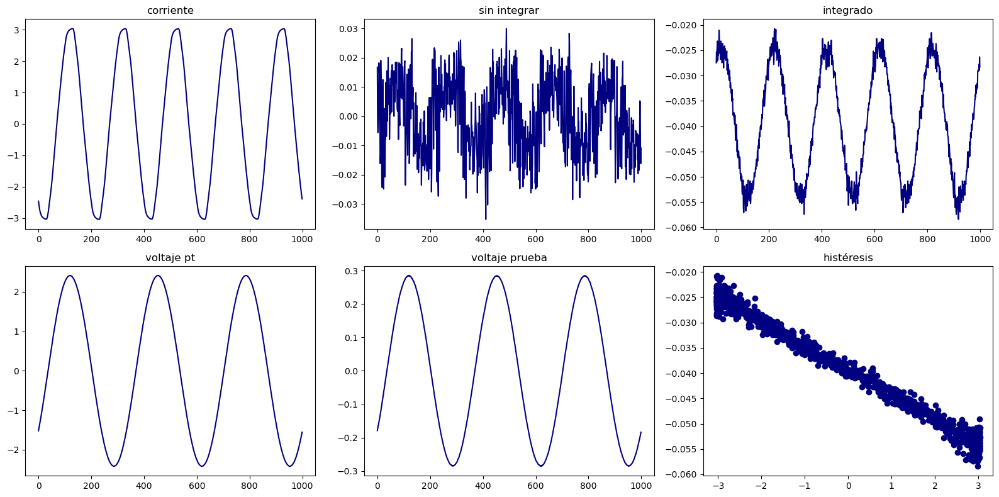

T = 288.55126938216836


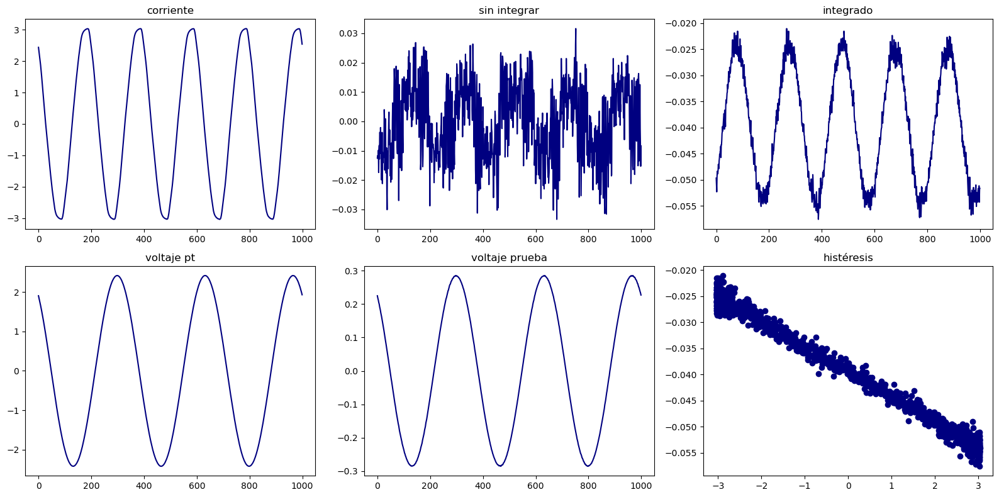

T = 288.7203756212734


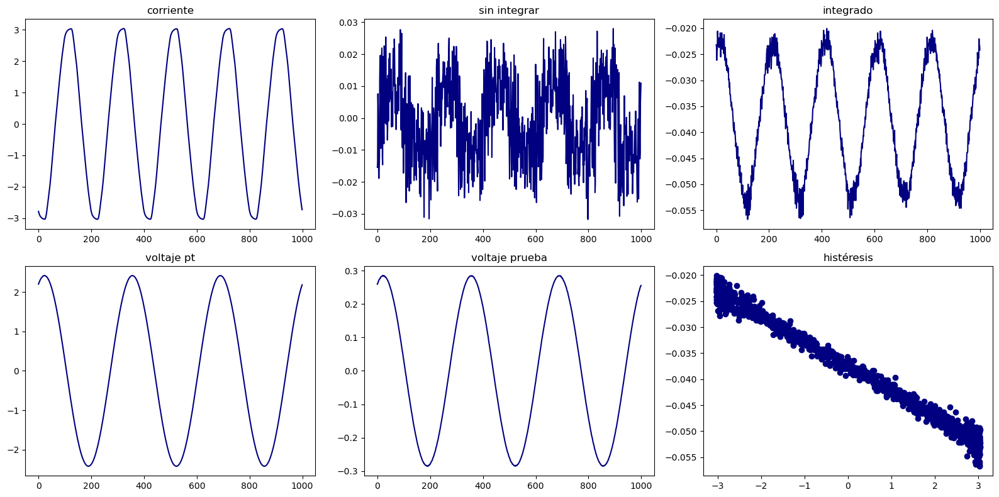

T = 288.9150711008112


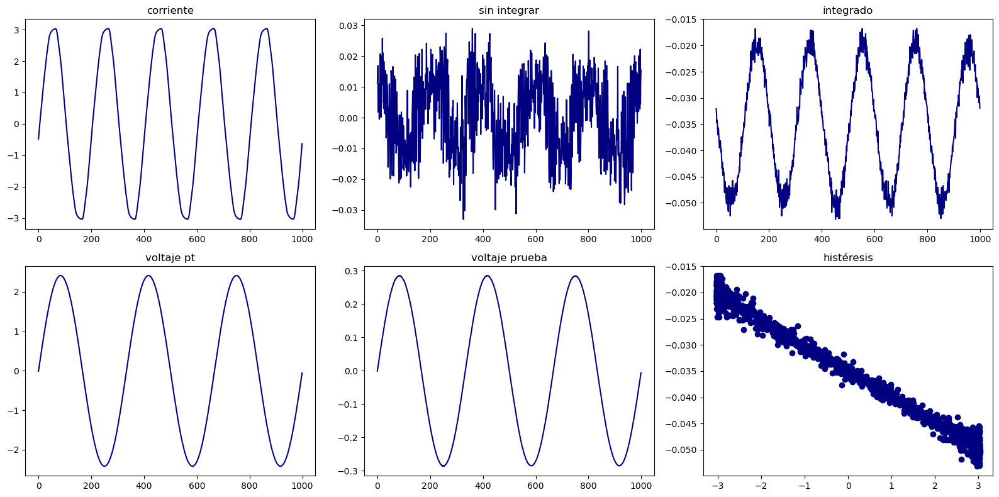

T = 289.2612625525093


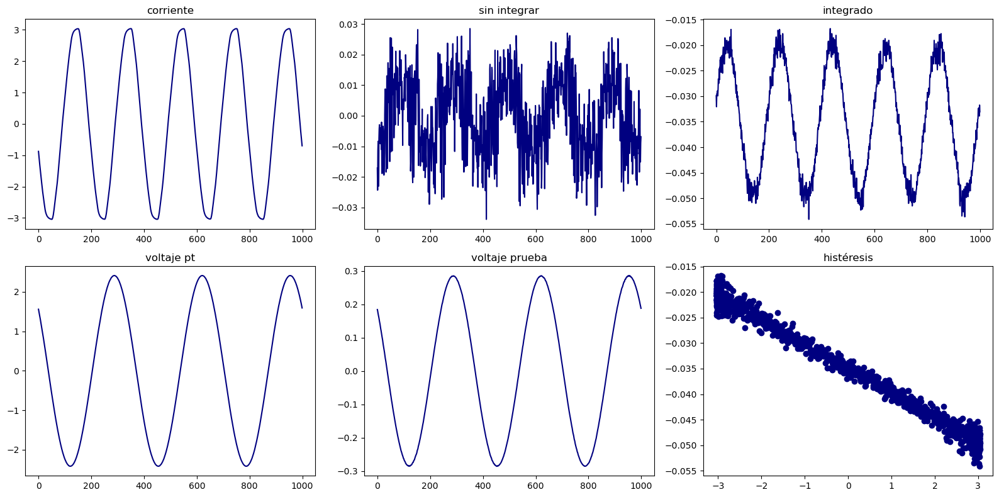

T = 289.49714357568155


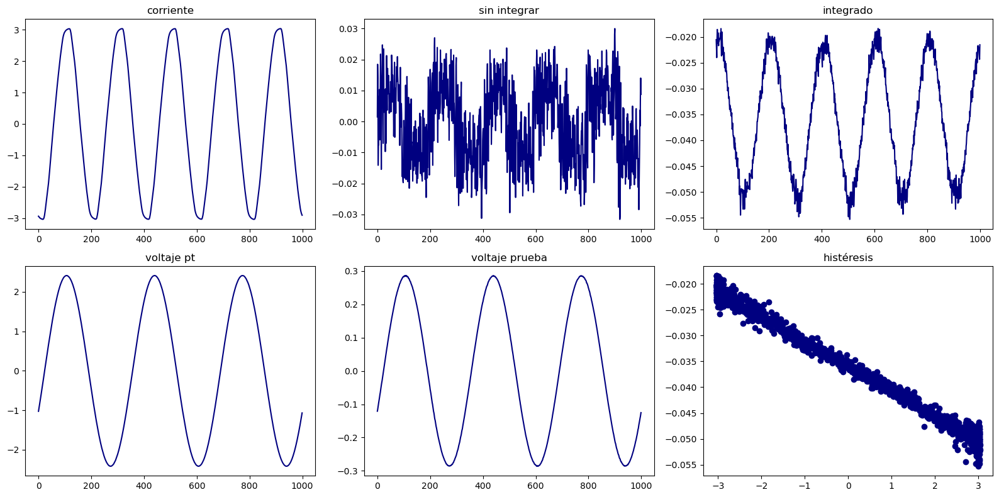

T = 289.68115117837823


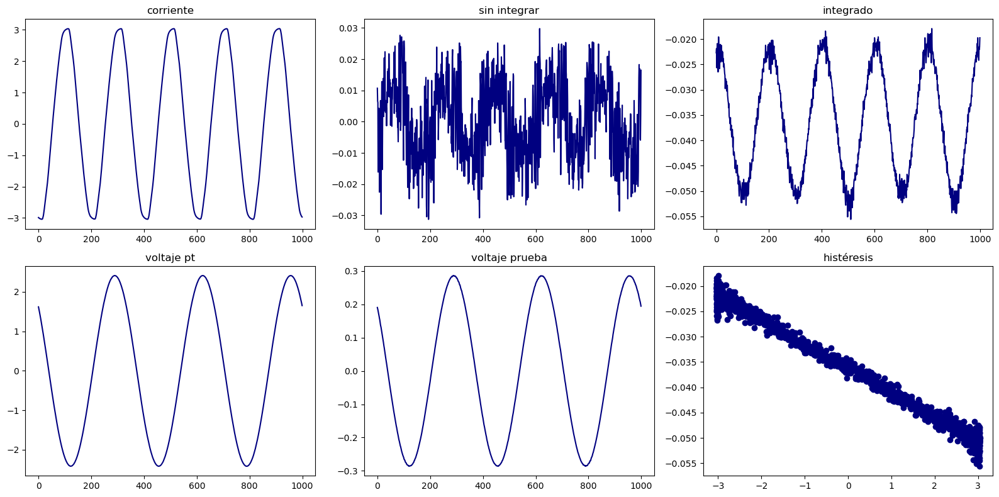

T = 289.84544279404196


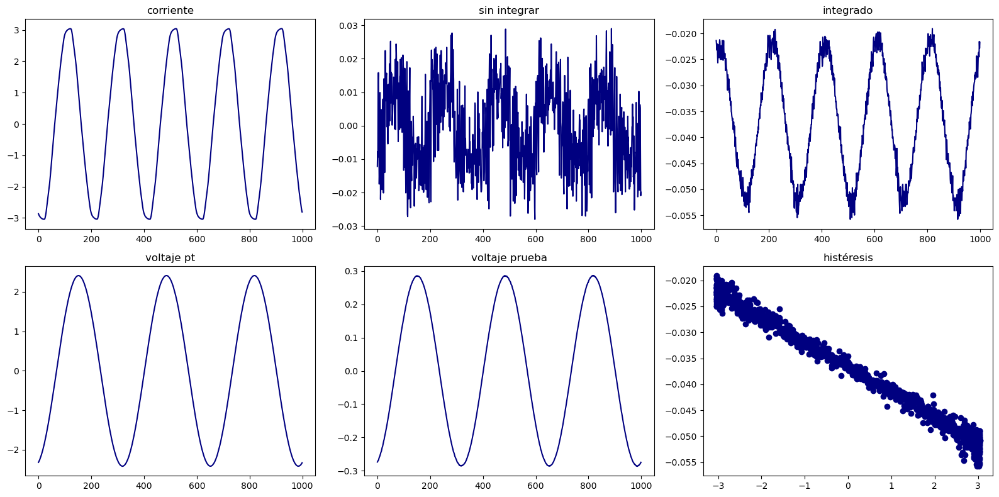

T = 289.9490615291163
FINALIZADO


[65.10481288412794,
 70.28699523995297,
 70.74632898605088,
 71.35523001697729,
 72.0028226784442,
 72.866830532743,
 73.96734440592829,
 75.19669603611726,
 76.4808886415465,
 77.51626794989818,
 78.82376359834174,
 86.53968367017612,
 87.76955630792685,
 89.07589155593783,
 90.22494350437128,
 91.29762245829735,
 92.28249974778043,
 93.28849938502401,
 94.35065981277847,
 95.30285752763763,
 96.25988663458983,
 104.53002247536898,
 105.38296670414508,
 106.11311349628863,
 106.9656594579416,
 107.80890772501888,
 108.73991784682431,
 109.47949234346697,
 110.36255362849559,
 111.094384572418,
 111.88715803077943,
 117.21037141057701,
 117.86898677996518,
 118.52163988354178,
 119.22785134763811,
 119.89922121404919,
 120.57450700806095,
 121.1925752968265,
 121.92447319847335,
 122.56061580699478,
 123.13811580758409,
 127.70944445175772,
 128.40351725299357,
 128.9355173587122,
 129.5399939436795,
 130.0692868787505,
 130.64851689226484,
 131.18026461103452,
 131.77875518591406,
 13

In [89]:
medir_hasta_t(180,'med2',0.1,10000,10)

In [50]:
def medir_hasta_dT(dT_f,folder,duracion_single,fs,interval):
    canales = [2,4,5,6,7]
    names = ['corriente','sin integrar','integrado','voltaje pt','voltaje prueba']
    t = 0
    counter = 0
    T = [60.10481288412794]
    dT = 0
    
    while dT > dT_f:
        counter += 1
        t_start = time.time()
        a = medir_canales(canales,duracion_single,fs)
        a[0] = -a[0]
        
        pars,cov = cf(lineal,a[3]/900,a[4])
        T.append(temp(pars[0]))
        dT = T[-1] - T[-2]
        
        if counter % interval == 0:
            fig, axs = plt.subplots(2,3,figsize=(16,8))
            axs = axs.ravel()
            for i in range(len(canales)):
                axs[i].plot(a[i],color='navy')
                axs[i].set_title(names[i])
            axs[-1].scatter(a[0],a[2],color='navy')
            axs[-1].set_title('histéresis')
            plt.tight_layout()
            plt.show()
            print(f'T = {T[-1]}')
        
        df = pd.DataFrame(np.transpose(a),columns=['V_H','V_Bnint','V_B','V_pt','V_pr'])        
        t_end = time.time()
        t += t_end - t_start
        df.to_csv(f'files/{folder}/{t}.csv')
    print('FINALIZADO')
    return T

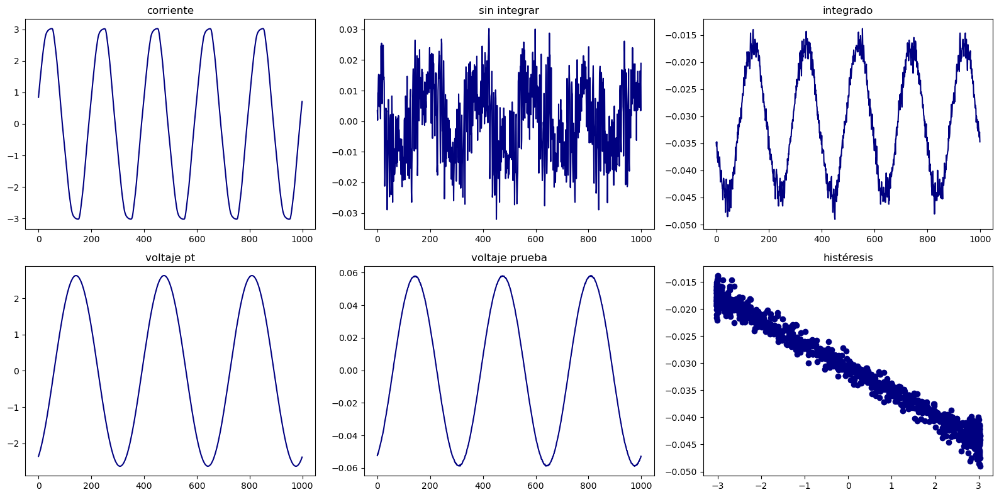

T = [65.10481288412794, 65.11213222894202, 65.11310472559956, 65.10399990501244, 65.08667077222904, 65.10848877392533, 65.12336524914292, 65.10658068721023, 65.12116785262168, 65.10645223869011, 65.10579507726155]


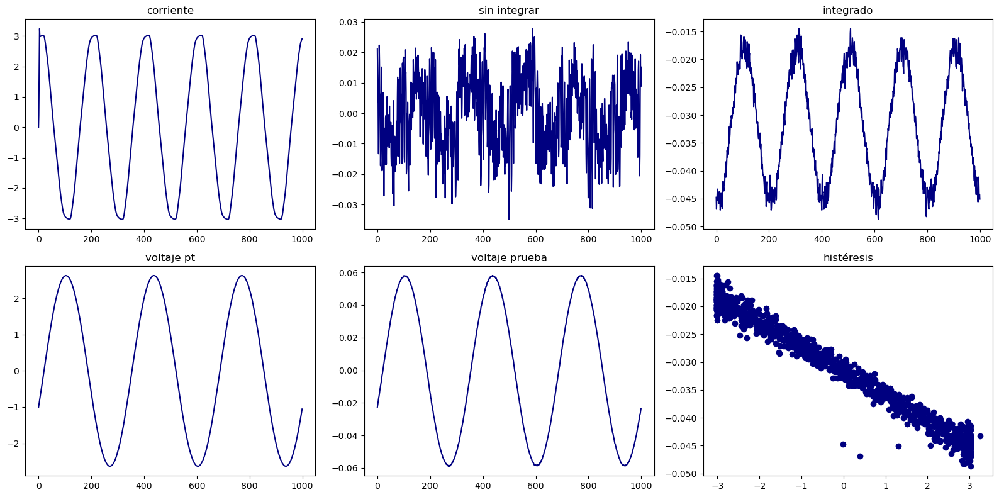

T = [65.10481288412794, 65.11213222894202, 65.11310472559956, 65.10399990501244, 65.08667077222904, 65.10848877392533, 65.12336524914292, 65.10658068721023, 65.12116785262168, 65.10645223869011, 65.10579507726155, 65.12275353731425, 65.11053728463952, 65.1209529509295, 65.11709395314108, 65.12372689476967, 65.12303035061072, 65.10942930913382, 65.1330735911306, 65.1050981896324, 65.11347554980415]


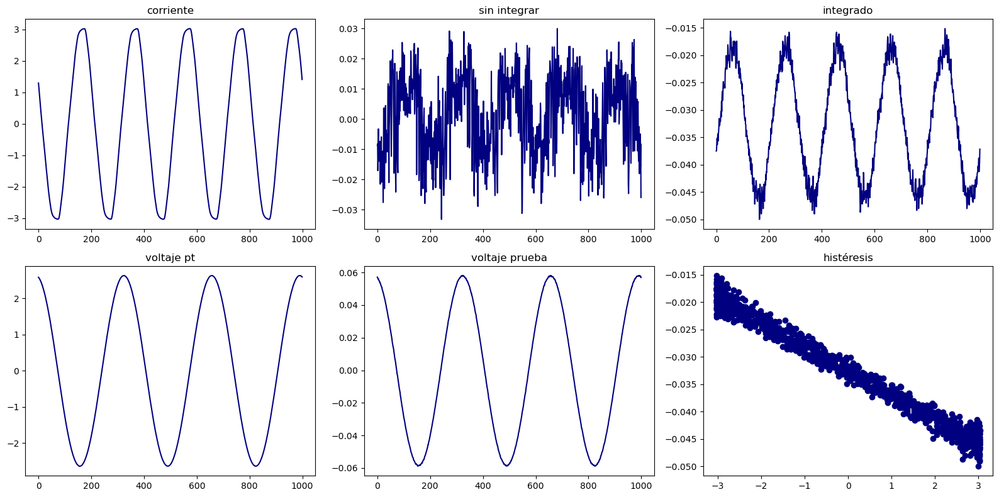

T = [65.10481288412794, 65.11213222894202, 65.11310472559956, 65.10399990501244, 65.08667077222904, 65.10848877392533, 65.12336524914292, 65.10658068721023, 65.12116785262168, 65.10645223869011, 65.10579507726155, 65.12275353731425, 65.11053728463952, 65.1209529509295, 65.11709395314108, 65.12372689476967, 65.12303035061072, 65.10942930913382, 65.1330735911306, 65.1050981896324, 65.11347554980415, 65.11117570906322, 65.10361924911527, 65.11948491392494, 65.10659455333553, 65.1105908000338, 65.09466836326939, 65.1113693374233, 65.09270085470175, 65.1175570055619, 65.1005467253888]


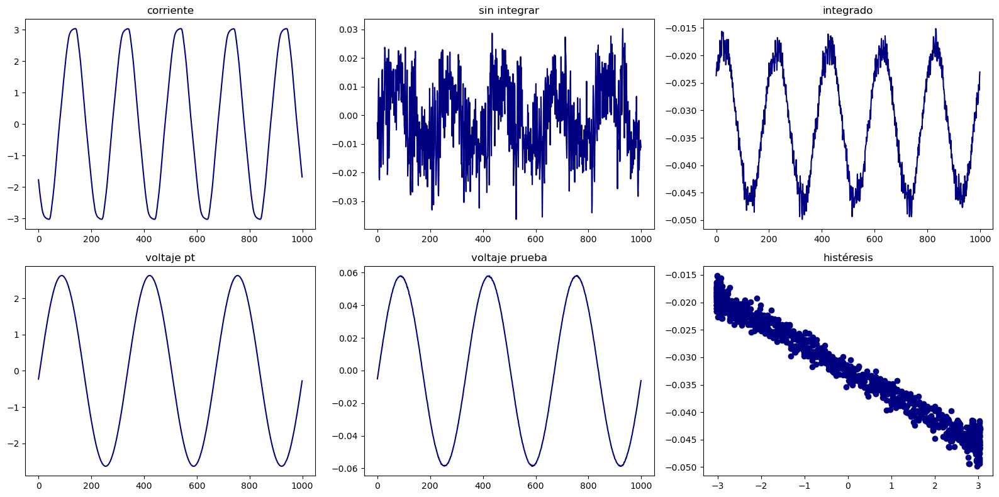

T = [65.10481288412794, 65.11213222894202, 65.11310472559956, 65.10399990501244, 65.08667077222904, 65.10848877392533, 65.12336524914292, 65.10658068721023, 65.12116785262168, 65.10645223869011, 65.10579507726155, 65.12275353731425, 65.11053728463952, 65.1209529509295, 65.11709395314108, 65.12372689476967, 65.12303035061072, 65.10942930913382, 65.1330735911306, 65.1050981896324, 65.11347554980415, 65.11117570906322, 65.10361924911527, 65.11948491392494, 65.10659455333553, 65.1105908000338, 65.09466836326939, 65.1113693374233, 65.09270085470175, 65.1175570055619, 65.1005467253888, 65.10228826418782, 65.10999351912668, 65.11437036387025, 65.10617712471074, 65.10225135594081, 65.09111314564254, 65.11789772795237, 65.09619419478341, 65.12683816949655, 65.11989190443163]


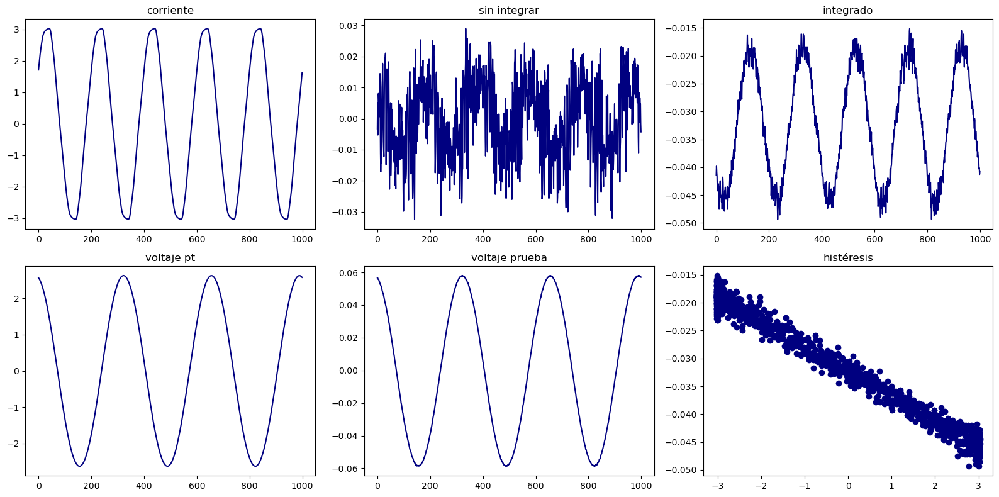

T = [65.10481288412794, 65.11213222894202, 65.11310472559956, 65.10399990501244, 65.08667077222904, 65.10848877392533, 65.12336524914292, 65.10658068721023, 65.12116785262168, 65.10645223869011, 65.10579507726155, 65.12275353731425, 65.11053728463952, 65.1209529509295, 65.11709395314108, 65.12372689476967, 65.12303035061072, 65.10942930913382, 65.1330735911306, 65.1050981896324, 65.11347554980415, 65.11117570906322, 65.10361924911527, 65.11948491392494, 65.10659455333553, 65.1105908000338, 65.09466836326939, 65.1113693374233, 65.09270085470175, 65.1175570055619, 65.1005467253888, 65.10228826418782, 65.10999351912668, 65.11437036387025, 65.10617712471074, 65.10225135594081, 65.09111314564254, 65.11789772795237, 65.09619419478341, 65.12683816949655, 65.11989190443163, 65.13966568263842, 65.09464542903092, 65.09250924624118, 65.11039097936447, 65.11038803899478, 65.13032396957425, 65.11376225284602, 65.11791255087184, 65.08666406456504, 65.09487107182156]


KeyboardInterrupt: 

In [46]:
medir_hasta_dT(10,'pruebasuperdiff',0.1,10000,10)